# Driver Alert Detection


In [1]:
!pip install ultralytics
!pip install split-folders
!pip install -U ipywidgets
!pip install tensorflow==2.13.0 protobuf==3.20.3

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 949.8/949.8 kB 15.6 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 139.8/139.8 kB 3.6 MB/s eta 0:00:00a 0:00:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 214.4/214.4 kB 8.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 45.7 MB/s eta 0:00:0000:01
  Attempting uninstall: widgetsnbextension
    Found existing installation: widgetsnbextension 3.6.7
    Uninstalling widgetsnbextension-3.6.7:
      Successfully uninstalled widgetsnbextension-3.6.7
  Attempting uninstall: jupyterlab-widgets
    Found existing installation: jupyterlab-widgets 3.0.9
    Uninstalling jupyterlab-widgets-3.0.9:
      Successfully uninstalled jupyterlab-widgets-3.0.9
  Attempting uninstall: ipywidgets
    Found existing installation: ipywidgets 7.7.1
    Uninstalling ipywidgets-7.7.1:
      Successfully uninstalled ipywidgets-7.7.1
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 524.1/524.1 MB 3.2 MB/s eta 0:00:00:00:0100:01


In [2]:
!pip install split-folders

#### *Importing all the libraries that we will be requiring during our project*

In [3]:
!pip install ultralytics

In [4]:
import csv
import os
from glob import glob
from shutil import copyfile
from random import shuffle, seed
import splitfolders
import tensorflow as tf
from tensorflow.keras import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten, BatchNormalization, Dropout
from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.vgg16 import VGG16
from ultralytics import YOLO
import pandas as pd
import numpy as np
from IPython.display import display, Image
from sklearn.metrics import accuracy_score
import matplotlib.pyplot as plt
%matplotlib inline

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


## Let us load our data and explore it a bit


In [5]:
import tensorflow as tf
import torch
print("TensorFlow version:", tf.__version__)
print("torch version:", torch.__version__)


TensorFlow version: 2.13.0
torch version: 2.1.2


As per the dataset below, we have `22424` images in the `training dataset`. We are gonna split it in three sets (train, val and test), respectively We will ignore `testing dataset` as we don't have any labels for them.

In [6]:
data = {}

with open('/kaggle/input/state-farm-distracted-driver-detection/driver_imgs_list.csv') as file:
    read_file = csv.reader(file)
    read_file = list(read_file)
    
    for row in read_file[1:]:
        key = row[1]
        if key in data:
            data[key].append(row[2])
        else:
            data[key] = [row[2]]

In [7]:
data['c0'][:5]

['img_44733.jpg',
 'img_72999.jpg',
 'img_25094.jpg',
 'img_69092.jpg',
 'img_92629.jpg']

We have 10 classes in total (`c0`, `c1`, `c2`, `c3`, `c4`, `c5`, `c6`, `c7`, `c8`, `c9`)

In [8]:
classes_list = list(data.keys())
classes_list

['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']

In [9]:
dataset_folder = '/kaggle/input/state-farm-distracted-driver-detection/imgs/'

train_dir = os.path.join(dataset_folder, 'train/')
test_dir = os.path.join(dataset_folder, 'test/')

In [10]:
print('Number of images in the training dataset : ', str(len(glob(train_dir+'*/*'))))
print('Number of images in the testing dataset : ', str(len(glob(test_dir+'*'))))

Number of images in the training dataset :  22424
Number of images in the testing dataset :  79726


## Reducing our dataset

For the sake of simplicity and to reduce the overall time taken to train all our model,we will reduce our dataset by 1/5th.

#### *Note: In case you are testing only one or two model. I would recommend to use whole dataset and use more layers in your models*

In [11]:
dataset_small_folder_path = '/kaggle/working/state-farm-distracted-driver-detection/smallset'
subfolders = classes_list

if os.path.exists(dataset_small_folder_path):
    for root, dirs, files in os.walk(dataset_small_folder_path, topdown = False):
        for name in files:
            file_path = os.path.join(root, name)
            os.remove(file_path)
        for name in dirs:
            dir_path = os.path.join(root, name)
            os.rmdir(dir_path)
    os.rmdir(path)
    
for folder in subfolders:
            subfolder_path = os.path.join(dataset_small_folder_path, folder)
            os.makedirs(subfolder_path)


In [12]:
for clas, images in data.items():
    length = len(images)
    seed(42)
    shuffle(images)
    for image in images[:int(length*0.2)]:
        source = os.path.join(dataset_folder, 'train/', clas, image)
        #print(source)                     
        destination = os.path.join(dataset_small_folder_path, clas, image)
        copyfile(source, destination)

In [13]:
print(dataset_small_folder_path)
for subfolder in subfolders:
    subfolder_path = os.path.join(dataset_small_folder_path, subfolder)
    print("Number of images for each class: ", subfolder, "->", len(os.listdir(subfolder_path)))

/kaggle/working/state-farm-distracted-driver-detection/smallset
Number of images for each class:  c0 -> 497
Number of images for each class:  c1 -> 453
Number of images for each class:  c2 -> 463
Number of images for each class:  c3 -> 469
Number of images for each class:  c4 -> 465
Number of images for each class:  c5 -> 462
Number of images for each class:  c6 -> 465
Number of images for each class:  c7 -> 400
Number of images for each class:  c8 -> 382
Number of images for each class:  c9 -> 425


In [14]:
small_dataset = {}
for subfolder in os.listdir(dataset_small_folder_path):
    small_dataset[subfolder] = os.listdir(os.path.join(dataset_small_folder_path, subfolder))

## Spliting Approach1 - For creating directories for training set, validation set and test set, using `os` and `shutil` modules

#### Writing helper function for creating directories for training set, validation set and test set
- `remove_directory` :- Removes the folder, subfolder and files within it
- `create_directories` :- Creates the folder and classes subfolders in each folder in the following order
    - `Folder`:- train or val or test
    - `Subfolders`:- All labeled classes *(('c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9'))*
    
**Note for the shake of simplicity and for reducing the total run time, we will reduce our dataset by the margin of ten.**

In [15]:
def remove_directory(path):
    for root, dirs, files in os.walk(path, topdown = False):
        for name in files:
            file_path = os.path.join(root, name)
            os.remove(file_path)
        for name in dirs:
            dir_path = os.path.join(root, name)
            os.rmdir(dir_path)
    os.rmdir(path)

In [16]:
def create_directories(paths, subfolders):
    for path in paths:
        if os.path.exists(path):
            remove_directory(path)
        
        for folder in subfolders:
            subfolder_path = os.path.join(path, folder)
            os.makedirs(subfolder_path)

#### We will store the path for the cleaned dataset containing train, val and test datasets in `paths` list and classes in subfolder list 

In [17]:
paths = ['/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train',
         '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val',
        '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test']

In [18]:
subfolders = classes_list

### Creating Train, Val, Test folders along with sub-directories (all Classes)

In [19]:
create_directories(paths, subfolders)

### Copying the image files to the cleaned dataset we have created using the above helper functions

Our dataset is splited in the following order using the `copyfile` submodule from the `shutil` module:
- Train -> 80% 
- Test, Val -> 10% each

In [20]:
split_size = [0.8, 0.1]


for clas, images in small_dataset.items():
    # print(len(images))
    train_size = int(split_size[0]*len(images))
    # print("Train size: ", train_size)
    
    test_size = int(split_size[1]*len(images))
    #print("Test size: ", test_size)
    
    train_images = images[:train_size]
    # print("Train Images Length", len(train_images))
    
    val_images = images[train_size: train_size + test_size]
    # print("Val Images Length", len(val_images))
    
    test_images = images[train_size + test_size:]
    # print("Test Images Length", len(test_images))
    
    
    
    for image in train_images:
        source = os.path.join(train_dir, clas, image)
        # print(os.path.exists(source))
        dest = os.path.join(paths[0], clas, image)
        copyfile(source, dest)
    
    for image in val_images:
        source = os.path.join(train_dir, clas, image)
        dest = os.path.join(paths[1], clas, image)
        copyfile(source, dest)
    
    for image in test_images:
        source = os.path.join(train_dir, clas, image)
        dest = os.path.join(paths[2], clas, image)
        copyfile(source, dest)

## Spliting Approach2 -  For creating directories for training set, validation set and test set, using `splitfolders` module

We will use a better approach for creating the cleaned dataset using splitfolders module.

Let us first delete the cleaned dataset created using the above function `create_directories()` and `copyfile` submodule

In [21]:
remove_directory('/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset')

### Creating the cleaned dataset now using splitfolder module.

The original dataset is splited in the following order and test, val, train subdirectories have been created automatically :
- Train -> 90%
- Test, Val -> 10% each

In [22]:
images_dir = '/kaggle/working/state-farm-distracted-driver-detection/smallset'
output_folder = '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset' 

split_ratio = (0.8, 0.1, 0.1)

# Note: the module will create val, train, test sub directories by itself in the background.
# No need for us to create those.
splitfolders.ratio(images_dir, output= output_folder, seed = 42, ratio= split_ratio)

Copying files: 4481 files [00:00, 6192.00 files/s]


#### Done ! Just needed one line of code.

#### Let us keep all our directory paths together at one place.
From now on, these Directory paths will be used for our training, validation and testing purpose

In [23]:
parent_dir = '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset'
train_dir = '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train'
val_dir = '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val'
test_dir = '/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test'

## Creating Function using Tensorflow's `ImageDataGenerator` Module for our image preprocessing

`imagedatageneration` function will be created that will return three generated batches of tensor image-data namely:-
- train_generator (generated from our train folder)
- val_generator (generated from our val folder)
- test_generator (generated from our test folder)

*Note: We will leverage the Data Augmentation facility of ImageDataGenerator module in training our model*

In [24]:
def imagedatageneration(train_dir, val_dir, test_dir, target_size = (256, 256), batch_size = 64):
    
    
    ## It can be seen that the augmentation is applied only on the training set.
    ## We have skipped it for val because it is not recommended. But we can try and experiment with it later
    
    train_datagen = ImageDataGenerator(rescale = 1.0 / 255,
                                       rotation_range = 30,
                                       width_shift_range = 0.1,
                                       height_shift_range = 0.1,
                                       zoom_range = 0.1,
                                       shear_range = 0.1,
                                       fill_mode = "nearest"
                                      )
    train_generator = train_datagen.flow_from_directory(
                                                            train_dir,
                                                            target_size = target_size,
                                                            class_mode = 'categorical',
                                                            shuffle = True,
                                                            batch_size = batch_size
                                                        )
    
    
    val_datagen = ImageDataGenerator(rescale = 1.0 / 255)
    
    val_generator = val_datagen.flow_from_directory(
                                                        val_dir,
                                                        target_size = target_size,
                                                        class_mode = 'categorical',
                                                        shuffle = True,
                                                        batch_size = batch_size
                                                    )
    
    test_datagen = ImageDataGenerator(rescale = 1.0/255)
    test_generator = test_datagen.flow_from_directory(
                                                        test_dir,
                                                        target_size = target_size,
                                                        class_mode = 'categorical',
                                                        shuffle = False,
                                                        batch_size = 1
                                                      )
    
    return train_generator, val_generator, test_generator

#### *`es` object is created using the EarlyStopping Class which will stop training when a monitored metric has stopped improving. We are monitoring validation accuracy in this case*

In [25]:
es = EarlyStopping(monitor = "val_acc",
                    min_delta = 0.0001,
                    verbose=1,
                    patience = 5,
                    restore_best_weights = True,
                    baseline = None)

#### `train_val_plot` function will compare the behaviour of Train and Validation Accuracies and Losses on each epoch for each of our Model

In [26]:
def train_val_plot(model, model_name):
    train_loss, train_acc, val_loss, val_acc = model.history['loss'], model.history['acc'], model.history['val_loss'], model.history['val_acc']
    
    plt.plot(train_acc)
    plt.plot(val_acc)
    plt.title('{} Model Accuracy'.format(model_name))
    plt.ylabel('Accuracy')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc = 'upper left')
    plt.show()
    
    
    plt.plot(train_loss)
    plt.plot(val_loss)
    plt.title('{} Model Loss'.format(model_name))
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc = 'upper left')
    plt.show()

## CNN Model

Loading our dataset using `imagedatageneration` function which will return three tuples with generated batches of tensor image-data namely:-

- `train_generator` (generated from our train folder)
- `val_generator` (generated from our val folder)
- `test_generator` (generated from our test folder)

In [27]:
train_generator, val_generator, test_generator = imagedatageneration(train_dir, val_dir, test_dir)


Found 3582 images belonging to 10 classes.
Found 444 images belonging to 10 classes.
Found 455 images belonging to 10 classes.


Our `Model2` consist of `6 Conv2D Layers`, with `5 Dense Layers` at the end.
We have applied `Batch normalization` after each Conv2D layer to keep a transformation that maintains the mean output close to 0 and the output standard deviation close to 1.

In [28]:
model2 = tf.keras.models.Sequential([
    Conv2D(16, (3, 3), activation = 'relu', input_shape = (256, 256, 3)),
    MaxPooling2D(2, 2),
    Conv2D(32, (3, 3), activation = 'relu'),
    MaxPooling2D(2, 2),
    Conv2D(64, (3, 3), activation = 'relu'),
    MaxPooling2D(2, 2),
    Flatten(),
    Dense(512, activation = 'relu'),
    Dense(1024, activation = 'relu'),
    BatchNormalization(),
    Dense(10, activation = 'softmax')
])

The Model is compiled using `Adam Optimizer` with the `learning rate of 0.001`. As it is a multi-label classification problem, we have used `categorical_crossentropy` as our loss function

In [29]:
model2.compile(optimizer = Adam(learning_rate = 0.001), loss = 'categorical_crossentropy', metrics = ['acc'])
model2.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 254, 254, 16)      448       
                                                                 
 max_pooling2d (MaxPooling2  (None, 127, 127, 16)      0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 125, 125, 32)      4640      
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 62, 62, 32)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 60, 60, 64)        18496     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 30, 30, 64)        0

The model will run for `15 epochs`. And it will stop before it if the metrics stopped improving as per the `EarlyStopping` object we have defined previously.

In [30]:
model2_history = model2.fit(train_generator,
            epochs = 15,
            verbose = 1,
            validation_data = val_generator,
            callbacks = [es])

Epoch 1/15
56/56 [==============================] - 150s 3s/step - loss: 2.0635 - acc: 0.2789 - val_loss: 2.1657 - val_acc: 0.2297
Epoch 2/15
56/56 [==============================] - 146s 3s/step - loss: 1.6858 - acc: 0.4054 - val_loss: 2.0359 - val_acc: 0.1869
Epoch 3/15
56/56 [==============================] - 145s 3s/step - loss: 1.4219 - acc: 0.5103 - val_loss: 2.4260 - val_acc: 0.1577
Epoch 4/15
56/56 [==============================] - 147s 3s/step - loss: 1.2582 - acc: 0.5687 - val_loss: 1.8001 - val_acc: 0.2770
Epoch 5/15
56/56 [==============================] - 145s 3s/step - loss: 1.1281 - acc: 0.6181 - val_loss: 1.3916 - val_acc: 0.4842
Epoch 6/15
56/56 [==============================] - 146s 3s/step - loss: 1.0273 - acc: 0.6438 - val_loss: 1.9322 - val_acc: 0.3941
Epoch 7/15
56/56 [==============================] - 148s 3s/step - loss: 0.9255 - acc: 0.6946 - val_loss: 1.8286 - val_acc: 0.3739
Epoch 8/15
56/56 [==============================] - 148s 3s/step - loss: 0.8785 - a

In [32]:
# Get true labels from test generator
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
true_labels = test_generator.classes

# Get class labels
class_labels = list(test_generator.class_indices.keys())

# Predict probabilities
pred_probs = model2.predict(test_generator, verbose=1)

# Convert probabilities to class predictions
pred_classes = np.argmax(pred_probs, axis=1)
# Generate classification report
print("Classification Report:")
print(classification_report(true_labels, pred_classes, target_names=class_labels))


455/455 [==============================] - 10s 21ms/step
Classification Report:
              precision    recall  f1-score   support

          c0       0.72      0.57      0.64        51
          c1       0.97      0.72      0.82        46
          c2       0.76      1.00      0.86        47
          c3       1.00      0.62      0.77        48
          c4       0.94      0.72      0.82        47
          c5       0.42      1.00      0.59        47
          c6       0.77      0.91      0.83        47
          c7       0.78      0.97      0.87        40
          c8       0.83      0.38      0.53        39
          c9       0.83      0.35      0.49        43

    accuracy                           0.73       455
   macro avg       0.80      0.73      0.72       455
weighted avg       0.80      0.73      0.73       455



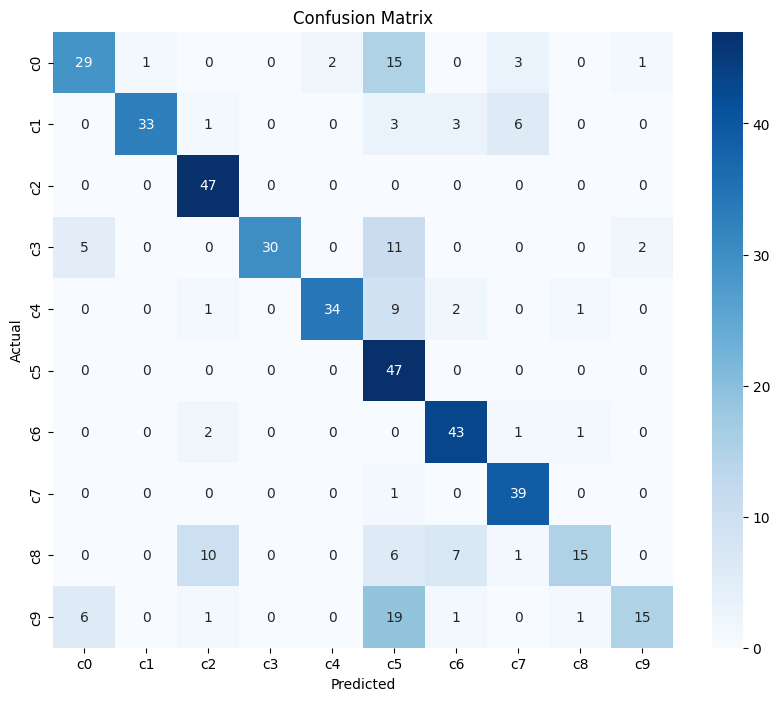

In [33]:
# Generate confusion matrix
cm = confusion_matrix(true_labels, pred_classes)

# Plot confusion matrix
plt.figure(figsize=(10, 8))
sns.heatmap(cm, annot=True, fmt='d', xticklabels=class_labels, yticklabels=class_labels, cmap='Blues')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()


Comparison of Train and Validation Accuracies and Losses on each epoch for our Model

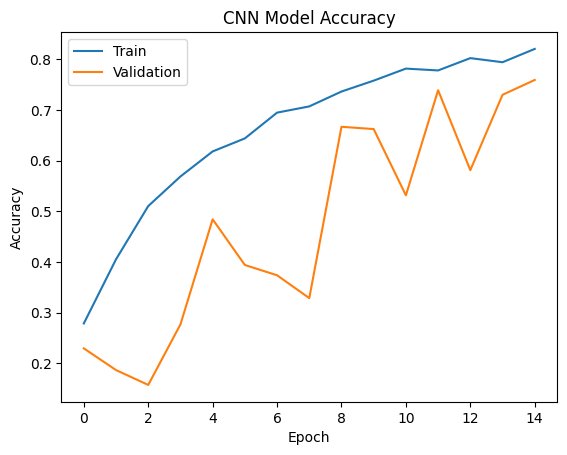

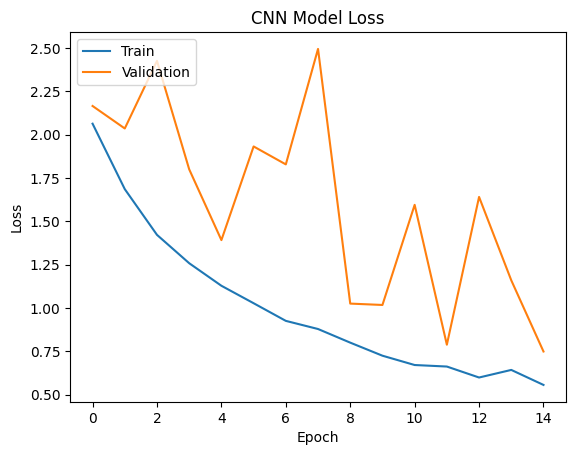

In [34]:
train_val_plot(model2_history, 'CNN')

## VGG16

Loading our dataset using `imagedatageneration` function which will return three tuples with generated batches of tensor image-data namely:-

- `train_generator` (generated from our train folder)
- `val_generator` (generated from our val folder)
- `test_generator` (generated from our test folder)

In [35]:
train_generator, val_generator, test_generator = imagedatageneration(train_dir, val_dir, test_dir)


Found 3582 images belonging to 10 classes.
Found 444 images belonging to 10 classes.
Found 455 images belonging to 10 classes.


Our `Model3` consist of pretrained model of VGG16 with 5 Dense Layers at the end.

We have applied `Batch normalization` after Dense layer to keep a transformation that maintains the mean output close to 0 and the output standard deviation close to 1. We have set all the layers apart from last 5 layers of our VGG16 models as `Non-trainable` during the training.

In [36]:
pretrained_model = VGG16(weights = 'imagenet', include_top = False, input_shape = (256, 256, 3))
pretrained_model.summary()

58889256/58889256 [==============================] - 0s 0us/step
Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                              

In [37]:
for layer in pretrained_model.layers[:-5]:
    layer.trainable = False

In [38]:
last_layer = pretrained_model.get_layer('block4_pool')
last_output = last_layer.output

x = Flatten()(last_output)
x = Dropout(0.2)(x)
x = Dense(128, activation = 'relu')(x)
x = BatchNormalization()(x)
x = Dense(256, activation = 'relu')(x)
x = BatchNormalization()(x)
x = Dense(10, activation = 'softmax')(x)


model3 = Model(pretrained_model.input, x)

The Model is compiled using `Adam Optimizer` with the `learning rate of 0.001`. As it is a multi-label classification problem, we have used `categorical_crossentropy` as our loss function

In [39]:
model3.compile(optimizer = Adam(learning_rate = 0.001), loss = 'categorical_crossentropy', metrics = ['acc'])
model3.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 256, 256, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 256, 256, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 256, 256, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 128, 128, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 128, 128, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 128, 128, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 64, 64, 128)       0     

The model will run for `15 epochs`. And it will stop before it if the metrics stopped improving as per the `EarlyStopping` object we have defined previously.

In [40]:
model3_history =  model3.fit(train_generator,
            epochs = 15,
            verbose = 1,
            validation_data = val_generator,
            callbacks = [es])

Epoch 1/15
56/56 [==============================] - 834s 15s/step - loss: 1.9435 - acc: 0.3576 - val_loss: 1.7609 - val_acc: 0.4595
Epoch 2/15
56/56 [==============================] - 858s 15s/step - loss: 0.9393 - acc: 0.6943 - val_loss: 1.1331 - val_acc: 0.6126
Epoch 3/15
56/56 [==============================] - 862s 15s/step - loss: 0.5895 - acc: 0.8132 - val_loss: 0.5673 - val_acc: 0.7973
Epoch 4/15
56/56 [==============================] - 851s 15s/step - loss: 0.4477 - acc: 0.8537 - val_loss: 0.2740 - val_acc: 0.9009
Epoch 5/15
56/56 [==============================] - 837s 15s/step - loss: 0.3789 - acc: 0.8800 - val_loss: 0.1583 - val_acc: 0.9459
Epoch 6/15
56/56 [==============================] - 869s 16s/step - loss: 0.3572 - acc: 0.8878 - val_loss: 0.1669 - val_acc: 0.9550
Epoch 7/15
56/56 [==============================] - 853s 15s/step - loss: 0.2816 - acc: 0.9095 - val_loss: 0.1729 - val_acc: 0.9459
Epoch 8/15
56/56 [==============================] - 837s 15s/step - loss: 0.

In [41]:
accuracy = model3.evaluate(test_generator)

print("Accuracy based on our VGG16 Model :- {:.2f}%".format(accuracy[1]*100))

455/455 [==============================] - 84s 184ms/step - loss: 0.1104 - acc: 0.9736
Accuracy based on our VGG16 Model :- 97.36%


In [42]:
# Get true labels from test generator
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
true_labels = test_generator.classes

# Get class labels
class_labels = list(test_generator.class_indices.keys())

# Predict probabilities
pred_probs = model3.predict(test_generator, verbose=1)

# Convert probabilities to class predictions
pred_classes = np.argmax(pred_probs, axis=1)
# Generate classification report
print("Classification Report:")
print(classification_report(true_labels, pred_classes, target_names=class_labels))


455/455 [==============================] - 83s 183ms/step
Classification Report:
              precision    recall  f1-score   support

          c0       0.98      0.96      0.97        51
          c1       1.00      0.98      0.99        46
          c2       1.00      0.98      0.99        47
          c3       0.92      1.00      0.96        48
          c4       0.98      0.98      0.98        47
          c5       1.00      1.00      1.00        47
          c6       0.98      0.96      0.97        47
          c7       0.93      1.00      0.96        40
          c8       0.95      0.92      0.94        39
          c9       1.00      0.95      0.98        43

    accuracy                           0.97       455
   macro avg       0.97      0.97      0.97       455
weighted avg       0.97      0.97      0.97       455



Comparison of Train and Validation Accuracies and Losses on each epoch for our Model

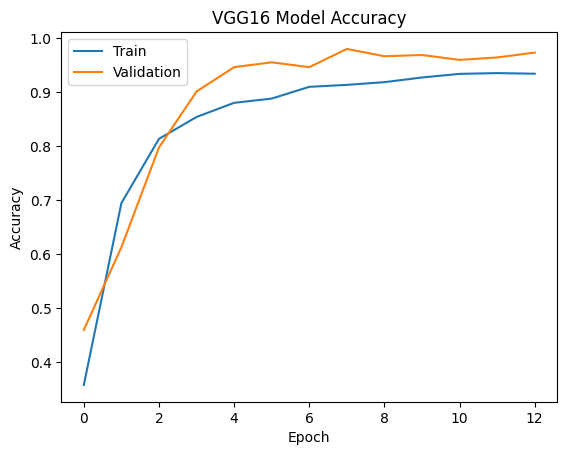

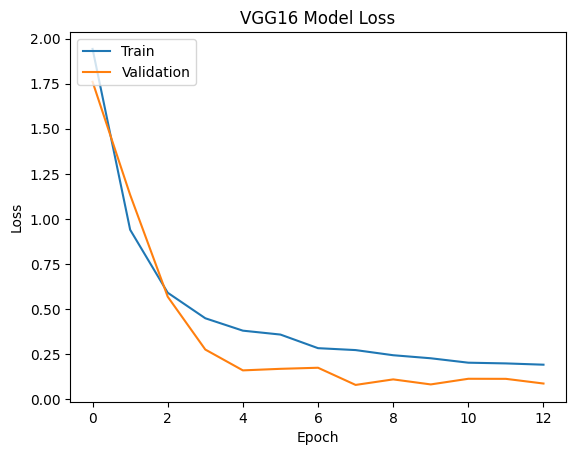

In [43]:
train_val_plot(model3_history, 'VGG16')


In [44]:
model3.save("/kaggle/working/vggmodel.h5")

/opt/conda/lib/python3.10/site-packages/keras/src/engine/training.py:3000: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


## ResNet50

Loading our dataset using `imagedatageneration` function which will return three tuples with generated batches of tensor image-data namely:-

- `train_generator` (generated from our train folder)
- `val_generator` (generated from our val folder)
- `test_generator` (generated from our test folder)

In [45]:
train_generator, val_generator, test_generator = imagedatageneration(train_dir, val_dir, test_dir)


Found 3582 images belonging to 10 classes.
Found 444 images belonging to 10 classes.
Found 455 images belonging to 10 classes.


Our `Model4` consist of pretrained model of ResNet50 with 5 Dense Layers at the end.

We have applied `Batch normalization` after Dense layer to keep a transformation that maintains the mean output close to 0 and the output standard deviation close to 1. We have set all the layers apart from last 3 layers of our Resnet50 models as `Non-trainable` during the training.

In [46]:
pretrained_model = ResNet50(weights = 'imagenet', include_top = False, input_shape = (256, 256, 3))
pretrained_model.summary()

94765736/94765736 [==============================] - 0s 0us/step
Model: "resnet50"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 262, 262, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 128, 128, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1_conv[0][0]']          
 on)                      

In [47]:
for layer in pretrained_model.layers[:-3]:
    layer.trainable = False


In [48]:
last_layer = pretrained_model.get_layer('conv5_block2_out')
last_output = last_layer.output

x = Flatten()(last_output)
x = Dropout(0.2)(x)
x = Dense(128, activation = 'relu')(x)
x = BatchNormalization()(x)
x = Dense(256, activation = 'relu')(x)
x = BatchNormalization()(x)
x = Dense(10, activation = 'softmax')(x)


model4 = Model(pretrained_model.input, x)

The Model is compiled using `Adam Optimizer` with the `learning rate of 0.001`. As it is a multi-label classification problem, we have used `categorical_crossentropy` as our loss function

In [49]:
model4.compile(optimizer = Adam(learning_rate = 0.001), loss = 'categorical_crossentropy', metrics = ['acc'])
model4.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_2 (InputLayer)        [(None, 256, 256, 3)]        0         []                            
                                                                                                  
 conv1_pad (ZeroPadding2D)   (None, 262, 262, 3)          0         ['input_2[0][0]']             
                                                                                                  
 conv1_conv (Conv2D)         (None, 128, 128, 64)         9472      ['conv1_pad[0][0]']           
                                                                                                  
 conv1_bn (BatchNormalizati  (None, 128, 128, 64)         256       ['conv1_conv[0][0]']          
 on)                                                                                        

The model will run for `15 epochs`. 

In [50]:
model4_history = model4.fit(train_generator,
            epochs = 15,
            verbose = 1,
            validation_data = val_generator)

Epoch 1/15
56/56 [==============================] - 436s 8s/step - loss: 2.2755 - acc: 0.2373 - val_loss: 8.6851 - val_acc: 0.1081
Epoch 2/15
56/56 [==============================] - 439s 8s/step - loss: 1.7705 - acc: 0.3825 - val_loss: 4.4076 - val_acc: 0.1509
Epoch 3/15
56/56 [==============================] - 435s 8s/step - loss: 1.6248 - acc: 0.4257 - val_loss: 2.6711 - val_acc: 0.1824
Epoch 4/15
56/56 [==============================] - 427s 8s/step - loss: 1.4993 - acc: 0.4782 - val_loss: 1.9679 - val_acc: 0.3288
Epoch 5/15
56/56 [==============================] - 465s 8s/step - loss: 1.4463 - acc: 0.4927 - val_loss: 1.4541 - val_acc: 0.4842
Epoch 6/15
56/56 [==============================] - 470s 8s/step - loss: 1.3503 - acc: 0.5209 - val_loss: 1.3852 - val_acc: 0.4707
Epoch 7/15
56/56 [==============================] - 482s 9s/step - loss: 1.2918 - acc: 0.5592 - val_loss: 0.9704 - val_acc: 0.6374
Epoch 8/15
56/56 [==============================] - 433s 8s/step - loss: 1.2618 - a

In [51]:
accuracy = model4.evaluate(test_generator)

print("Accuracy based on our ResNet50 Model :- {:.2f}%".format(accuracy[1]*100))

455/455 [==============================] - 41s 89ms/step - loss: 0.7108 - acc: 0.7604
Accuracy based on our ResNet50 Model :- 76.04%


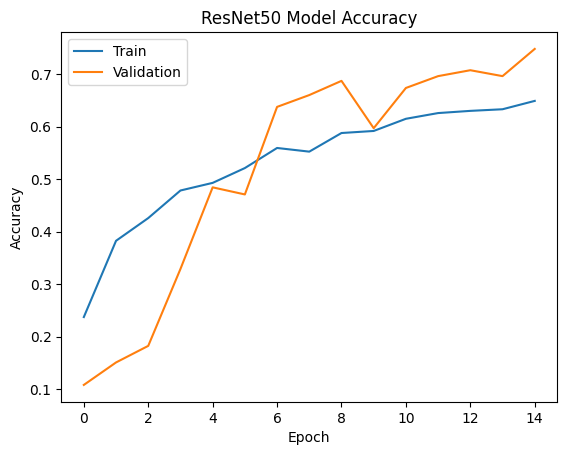

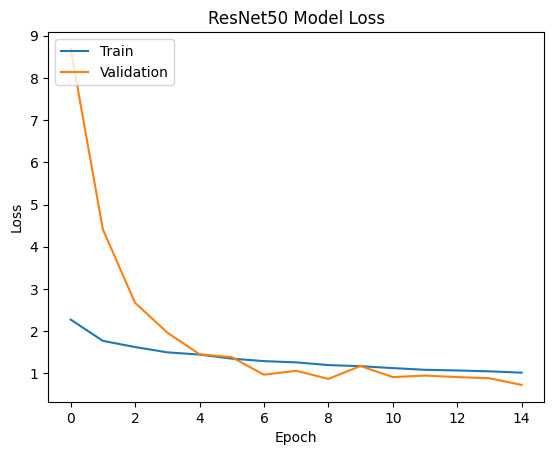

In [52]:
train_val_plot(model4_history, 'ResNet50')

In [53]:
# Get true labels from test generator
from sklearn.metrics import classification_report, confusion_matrix
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
true_labels = test_generator.classes

# Get class labels
class_labels = list(test_generator.class_indices.keys())

# Predict probabilities
pred_probs = model4.predict(test_generator, verbose=1)

# Convert probabilities to class predictions
pred_classes = np.argmax(pred_probs, axis=1)
# Generate classification report
print("Classification Report:")
print(classification_report(true_labels, pred_classes, target_names=class_labels))


455/455 [==============================] - 43s 93ms/step
Classification Report:
              precision    recall  f1-score   support

          c0       0.59      0.73      0.65        51
          c1       0.95      0.78      0.86        46
          c2       0.66      0.89      0.76        47
          c3       0.94      0.62      0.75        48
          c4       0.79      0.57      0.67        47
          c5       0.76      1.00      0.86        47
          c6       0.95      0.87      0.91        47
          c7       1.00      0.68      0.81        40
          c8       0.62      0.72      0.67        39
          c9       0.66      0.72      0.69        43

    accuracy                           0.76       455
   macro avg       0.79      0.76      0.76       455
weighted avg       0.79      0.76      0.76       455



## Yolo v8

### Creating the object of out Yolo model

In [54]:
model5 = YOLO('yolov8n-cls.pt')

100%|██████████| 5.31M/5.31M [00:00<00:00, 73.4MB/s]


#### Below we have trained our `YOLO` model with `20 epochs` on the training dataset we have created

In [55]:
# Import wandb and log in
import wandb
from kaggle_secrets import UserSecretsClient
user_secrets = UserSecretsClient()
my_secret = user_secrets.get_secret("wandb_api_key") 



# Log in to wandb with API key
wandb.login(key=my_secret)

wandb: W&B API key is configured. Use `wandb login --relogin` to force relogin
wandb: WARNING If you're specifying your api key in code, ensure this code is not shared publicly.
wandb: WARNING Consider setting the WANDB_API_KEY environment variable, or running `wandb login` from the command line.
wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


True

In [56]:
results = model5.train(data = parent_dir, epochs = 15)

Ultralytics 8.3.94 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
engine/trainer: task=classify, mode=train, model=yolov8n-cls.pt, data=/kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset, epochs=15, time=None, patience=100, batch=16, imgsz=224, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_

100%|██████████| 5.35M/5.35M [00:00<00:00, 74.1MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train... 3582 images, 0 corrupt: 100%|██████████| 3582/3582 [00:01<00:00, 2667.22it/s]

train: New cache created: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train.cache



/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val... 444 images, 0 corrupt: 100%|██████████| 444/444 [00:00<00:00, 3993.01it/s]

val: New cache created: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val.cache



/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000714, momentum=0.9) with parameter groups 26 weight(decay=0.0), 27 weight(decay=0.0005), 27 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 224 train, 224 val
Using 4 dataloader workers
Logging results to runs/classify/train
Starting training for 15 epochs...

      Epoch    GPU_mem       loss  Instances       Size


       1/15     0.369G      2.331         16        224:   3%|▎         | 7/224 [00:01<00:25,  8.63it/s]

       1/15     0.369G      2.332         16        224:   6%|▌         | 13/224 [00:01<00:18, 11.71it/s]
100%|██████████| 755k/755k [00:00<00:00, 15.6MB/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.52it/s]

                   all      0.743      0.966



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 16.97it/s]

                   all      0.919      0.995



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 15.61it/s]

                   all      0.932          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 15.62it/s]

                   all      0.953          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.55it/s]

                   all      0.966          1



/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.22it/s]

                   all      0.971          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:01<00:00, 13.89it/s]

                   all      0.971          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 15.97it/s]

                   all      0.975          1



      Epoch    GPU_mem       loss  Instances       Size


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.79it/s]

                   all      0.973          1



      Epoch    GPU_mem       loss  Instances       Size


      10/15     0.375G     0.1526         14        224: 100%|██████████| 224/224 [00:15<00:00, 14.53it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 17.16it/s]

                   all       0.98          1



      Epoch    GPU_mem       loss  Instances       Size


      11/15     0.375G     0.1637         14        224: 100%|██████████| 224/224 [00:14<00:00, 15.23it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 15.76it/s]

                   all       0.98          1



      Epoch    GPU_mem       loss  Instances       Size


      12/15     0.375G      0.132         14        224: 100%|██████████| 224/224 [00:15<00:00, 14.69it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 18.10it/s]

                   all      0.982          1



      Epoch    GPU_mem       loss  Instances       Size


      13/15     0.375G     0.1266         14        224: 100%|██████████| 224/224 [00:14<00:00, 15.25it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 16.80it/s]

                   all      0.989          1



      Epoch    GPU_mem       loss  Instances       Size


      14/15     0.375G     0.1315         14        224: 100%|██████████| 224/224 [00:15<00:00, 14.84it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.01it/s]

                   all      0.991          1



      Epoch    GPU_mem       loss  Instances       Size


      15/15     0.375G     0.1185         14        224: 100%|██████████| 224/224 [00:14<00:00, 15.44it/s]
               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:00<00:00, 14.60it/s]

                   all      0.989          1



15 epochs completed in 0.069 hours.
Optimizer stripped from runs/classify/train/weights/last.pt, 3.0MB
Optimizer stripped from runs/classify/train/weights/best.pt, 3.0MB

Validating runs/classify/train/weights/best.pt...
Ultralytics 8.3.94 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-cls summary (fused): 30 layers, 1,447,690 parameters, 0 gradients, 3.3 GFLOPs
train: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train... found 3582 images in 10 classes ✅ 
val: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val... found 444 images in 10 classes ✅ 
test: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test... found 455 images in 10 classes ✅ 


               classes   top1_acc   top5_acc: 100%|██████████| 14/14 [00:01<00:00, 13.73it/s]


                   all      0.991          1
Speed: 0.1ms preprocess, 1.8ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/train


#### Validating our model performance on the validation dataset

In [57]:
model5.val()

Ultralytics 8.3.94 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16269MiB)
YOLOv8n-cls summary (fused): 30 layers, 1,447,690 parameters, 0 gradients, 3.3 GFLOPs
train: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/train... found 3582 images in 10 classes ✅ 
val: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val... found 444 images in 10 classes ✅ 
test: /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test... found 455 images in 10 classes ✅ 


val: Scanning /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/val... 444 images, 0 corrupt: 100%|██████████| 444/444 [00:00<?, ?it/s]
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
               classes   top1_acc   top5_acc: 100%|██████████| 28/28 [00:02<00:00, 12.99it/s]


                   all      0.991          1
Speed: 0.2ms preprocess, 1.9ms inference, 0.0ms loss, 0.0ms postprocess per image
Results saved to runs/classify/train2


ultralytics.utils.metrics.ClassifyMetrics object with attributes:

confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7b3942d8a350>
curves: []
curves_results: []
fitness: 0.9954954981803894
keys: ['metrics/accuracy_top1', 'metrics/accuracy_top5']
results_dict: {'metrics/accuracy_top1': 0.9909909963607788, 'metrics/accuracy_top5': 1.0, 'fitness': 0.9954954981803894}
save_dir: PosixPath('runs/classify/train2')
speed: {'preprocess': 0.241550853593458, 'inference': 1.9329683918758664, 'loss': 0.0009326464056062537, 'postprocess': 0.001999894151480361}
task: 'classify'
top1: 0.9909909963607788
top5: 1.0

In [58]:
df= pd.read_csv('/kaggle/working/runs/classify/train/results.csv')
df.head()

,epoch,time,train/loss,metrics/accuracy_top1,metrics/accuracy_top5,val/loss,lr/pg0,lr/pg1,lr/pg2
0,1,19.0673,2.08354,0.74324,0.96622,1.11227,0.000237,0.000237,0.000237
1,2,35.8319,0.85588,0.91892,0.99550,0.28074,0.000444,0.000444,0.000444
2,3,52.0874,0.44663,0.93243,1.00000,0.18888,0.000619,0.000619,0.000619
3,4,68.7517,0.36517,0.95270,1.00000,0.15053,0.000573,0.000573,0.000573
4,5,84.8995,0.29684,0.96622,1.00000,0.09761,0.000526,0.000526,0.000526


#### Comparison of Train and Validation Losses for our Model

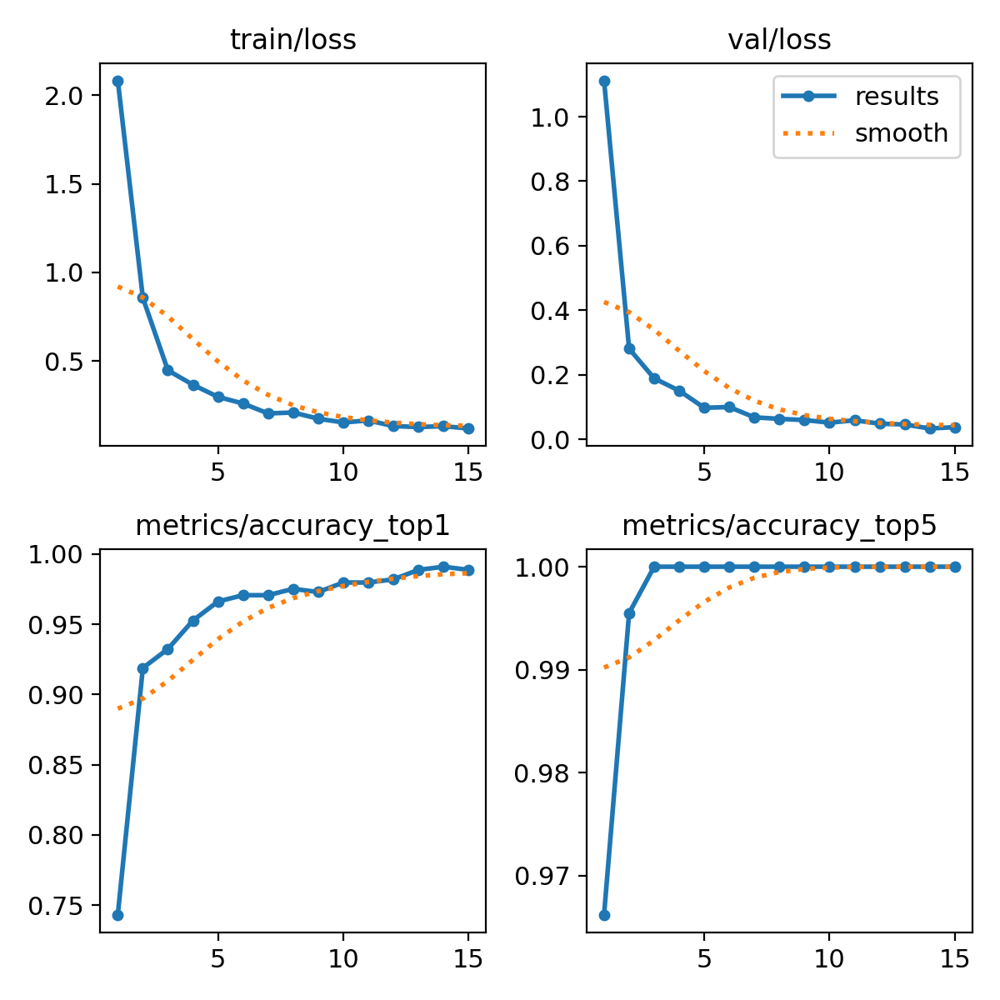

In [59]:
Image("/kaggle/working/runs/classify/train/results.png")

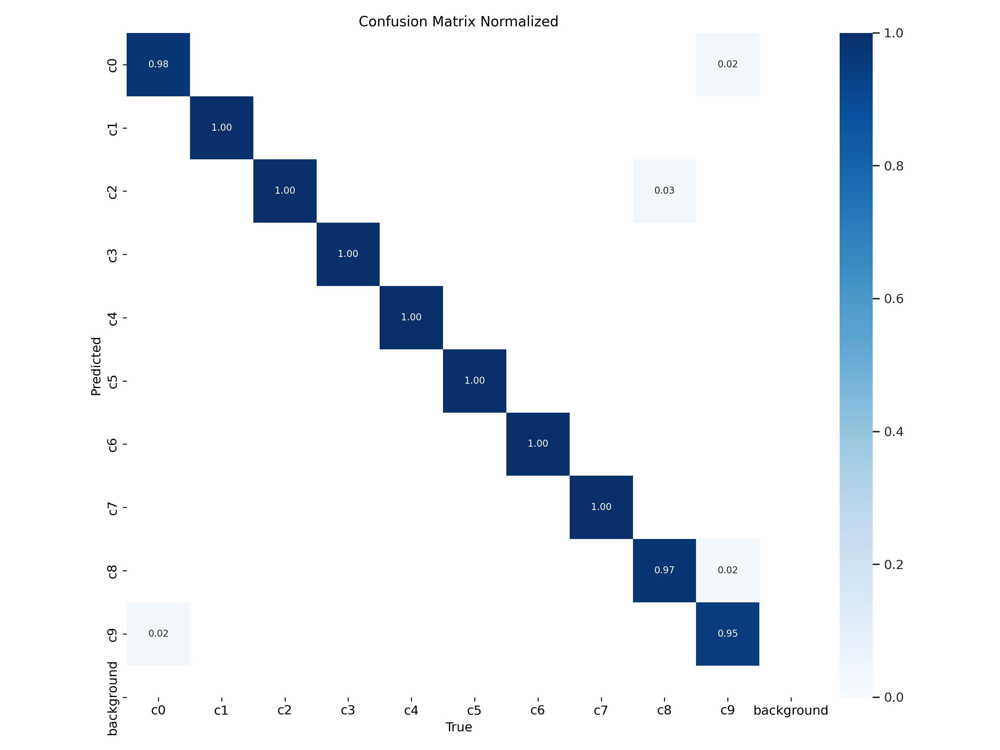

In [60]:
Image("/kaggle/working/runs/classify/train/confusion_matrix_normalized.png")

### Predicting our model performance on the test dataset we have created.

Below we compare the test images one by one and compare the result with their original class.

Overall accuracy came out `99.44%` on our test dataset.

In [61]:
classes = ['c0', 'c1', 'c2', 'c3', 'c4', 'c5', 'c6', 'c7', 'c8', 'c9']
test_images_path = test_dir
model_weights = "/kaggle/working/runs/classify/train/weights/best.pt"

predicted_list = []

for clas in classes:
    image_dir = os.path.join(test_images_path, clas)
    # print(image_dir)
    images_list = os.listdir(image_dir)
    # print(images_list)
    # Class label in the form of 0 to 9
    class_label = int(clas[-1])
    # print(class_label)
    for image in images_list:
        path = os.path.join(image_dir, image)
        # print(path)
        y_actual = class_label
        y_predicted = model5.predict(path, model = model_weights)[0].probs.top1
        predicted_list.append([path, y_actual, y_predicted])


image 1/1 /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test/c0/img_52101.jpg: 224x224 c0 1.00, c9 0.00, c8 0.00, c3 0.00, c2 0.00, 2.9ms
Speed: 11.8ms preprocess, 2.9ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test/c0/img_42587.jpg: 224x224 c0 0.97, c9 0.03, c1 0.00, c2 0.00, c8 0.00, 2.8ms
Speed: 5.1ms preprocess, 2.8ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test/c0/img_94437.jpg: 224x224 c0 1.00, c3 0.00, c9 0.00, c5 0.00, c1 0.00, 3.6ms
Speed: 5.7ms preprocess, 3.6ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)

image 1/1 /kaggle/working/state-farm-distracted-driver-detection/cleaned_dataset/test/c0/img_100456.jpg: 224x224 c0 1.00, c9 0.00, c4 0.00, c3 0.00, c2 0.00, 3.6ms
Speed: 6.3ms preprocess, 3.6ms inference, 0.1ms postpr

In [62]:
print("length of the Predicted List : ", len(predicted_list))

length of the Predicted List :  455


In [63]:
df = pd.DataFrame(predicted_list, columns = ['Image_path', 'Y_actual', 'Y_predicted'])

In [64]:
print("Accuracy based on our VOLO V8 Model :- {:.2f}%".format(accuracy_score(df['Y_actual'], df['Y_predicted'])*100))

Accuracy based on our VOLO V8 Model :- 98.46%


## Conclusion

In our project, we have used two method for creating directories for training set, validation set and test set. One, with our standard `os` module and other using simpler method by taking the benefit of `splitfolders` module.

We have trained the dataset using the below models. Each Model is trained till 20Epochs. Moreover, comparison between the behaviour of Train and Validation Accuracies and Losses on each epoch for each of our Model has been made. (For the Previous Running version)


- **VGG16 Model** - Test Acc. (**97.58%**)
- **RestNet50 Model** - Test Acc. (**77.80%**)
- **Yolo v8 Model** - Test Acc. (**98.46%**)

### Test Accuracy Perfomance Order

Model1 (Simple Dense) -> Model3 (ResNet50) -> Model2 (CNN) -> Model3 (VGG16) -> Model5 (YOLOv8)

**Note**: This is just the start of the analysis. These models can be improved further with the addition/removal of some of the layers, fine tuning hyperparameters, changing the size of the splited datasets, epochs, data augmentation and so on.

In [65]:
from ultralytics import YOLO
import os

# Load your trained YOLOv8 classification model
model_path = "/kaggle/working/runs/classify/train/weights/best.pt"
model = YOLO(model_path)

# Define your class labels
classes = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',   # c2
    'texting - left',                 # c3
    'talking on the phone - left',    # c4
    'operating the radio',            # c5
    'drinking',                       # c6
    'reaching behind',                # c7
    'hair and makeup',                # c8
    'talking to passenger'            # c9
]

# Function to predict a single image
def predict_single_image(image_path):
    result = model(image_path)[0]
    class_index = result.probs.top1
    class_name = classes[class_index]
    confidence = result.probs.top1conf
    print(f"✅ Predicted Class: {class_name} (Index: {class_index})")
    print(f"📊 Confidence Score: {confidence:.2f}")
    return class_name, confidence

# Example usage:
predict_single_image("/kaggle/input/state-farm-distracted-driver-detection/imgs/test/img_100496.jpg")  # Replace with your image path



image 1/1 /kaggle/input/state-farm-distracted-driver-detection/imgs/test/img_100496.jpg: 224x224 c9 0.94, c7 0.05, c8 0.01, c2 0.00, c0 0.00, 3.3ms
Speed: 6.2ms preprocess, 3.3ms inference, 0.1ms postprocess per image at shape (1, 3, 224, 224)
✅ Predicted Class: talking to passenger (Index: 9)
📊 Confidence Score: 0.94


('talking to passenger', tensor(0.9442, device='cuda:0'))


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.81, c8 0.06, c3 0.06, c9 0.05, c4 0.01, 69.4ms
Speed: 16.3ms preprocess, 69.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 0 → operating the radio (0.81)


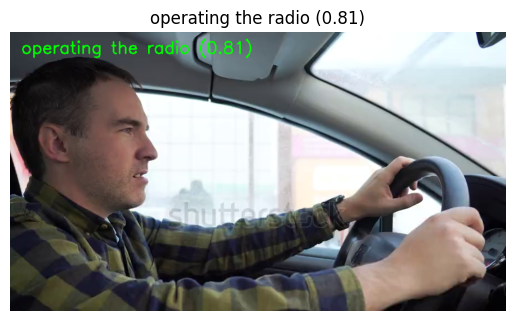


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.63, c8 0.19, c9 0.09, c3 0.07, c0 0.02, 74.4ms
Speed: 20.1ms preprocess, 74.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 5 → operating the radio (0.63)


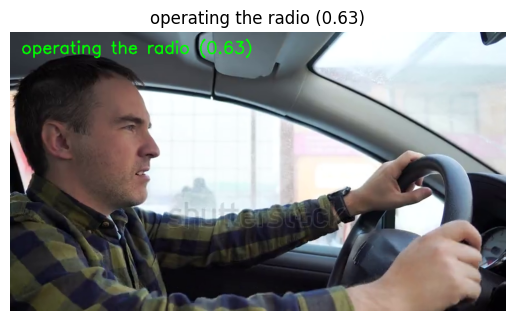


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.33, c5 0.32, c7 0.14, c3 0.12, c9 0.04, 64.4ms
Speed: 18.0ms preprocess, 64.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 10 → hair and makeup (0.33)


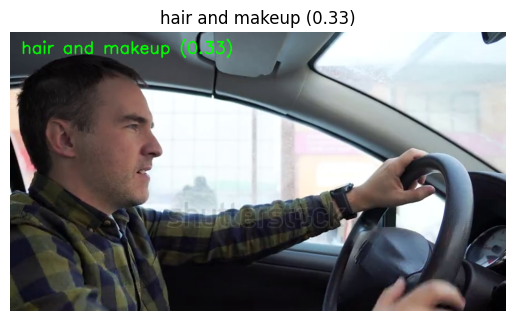


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.34, c7 0.24, c8 0.18, c3 0.14, c9 0.04, 64.5ms
Speed: 18.1ms preprocess, 64.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 15 → operating the radio (0.34)


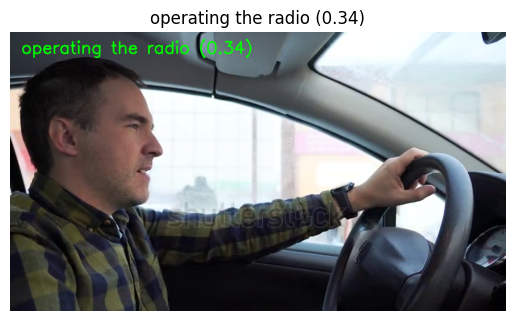


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.40, c8 0.36, c3 0.11, c7 0.09, c0 0.01, 66.8ms
Speed: 18.1ms preprocess, 66.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 20 → operating the radio (0.40)


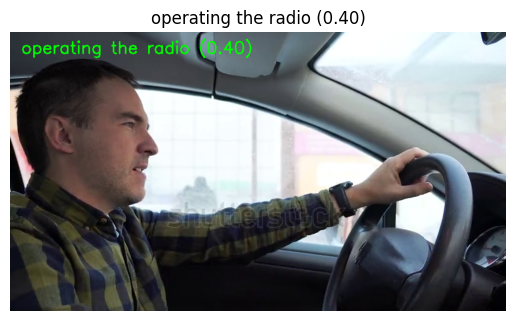


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.34, c7 0.26, c3 0.17, c5 0.15, c9 0.03, 72.5ms
Speed: 16.1ms preprocess, 72.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 25 → hair and makeup (0.34)


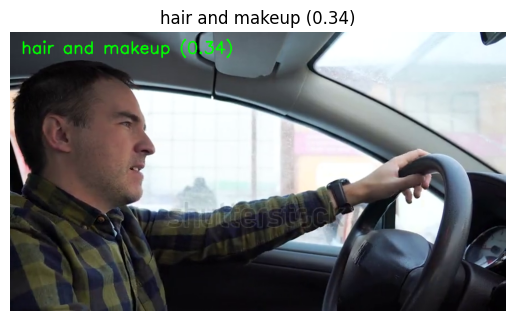


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.30, c8 0.29, c7 0.17, c3 0.16, c9 0.04, 63.1ms
Speed: 19.2ms preprocess, 63.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 30 → operating the radio (0.30)


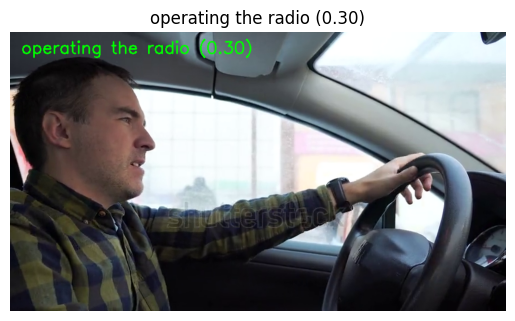


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.35, c3 0.24, c8 0.20, c7 0.14, c0 0.04, 72.2ms
Speed: 17.4ms preprocess, 72.2ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 35 → operating the radio (0.35)


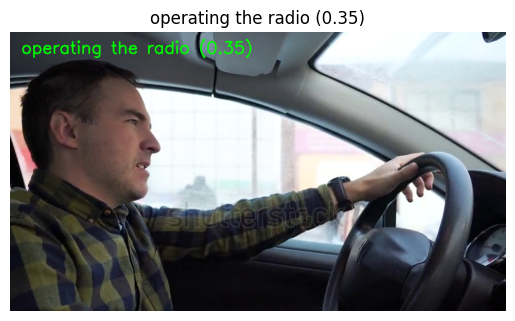


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.52, c8 0.19, c7 0.13, c3 0.10, c0 0.03, 71.4ms
Speed: 17.1ms preprocess, 71.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 40 → operating the radio (0.52)


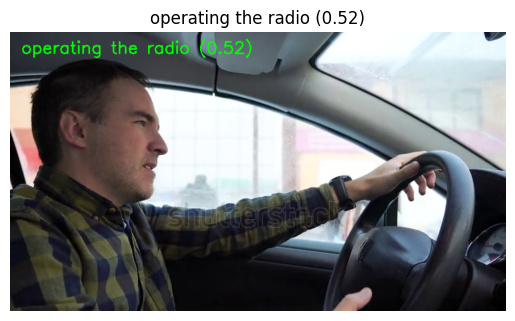


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.56, c1 0.16, c3 0.10, c7 0.07, c5 0.06, 68.6ms
Speed: 15.0ms preprocess, 68.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 45 → hair and makeup (0.56)


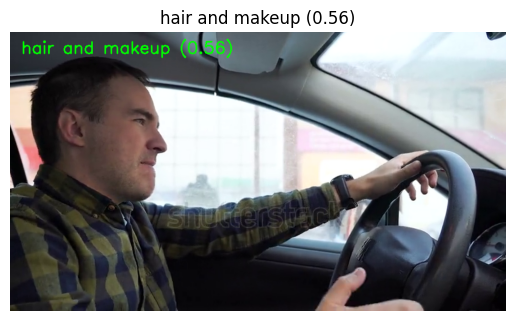


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.71, c5 0.21, c0 0.02, c9 0.02, c3 0.02, 74.2ms
Speed: 17.1ms preprocess, 74.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 50 → hair and makeup (0.71)


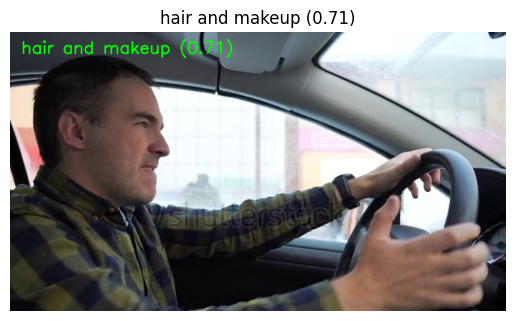


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.50, c8 0.26, c3 0.10, c9 0.08, c0 0.05, 69.6ms
Speed: 18.4ms preprocess, 69.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 55 → operating the radio (0.50)


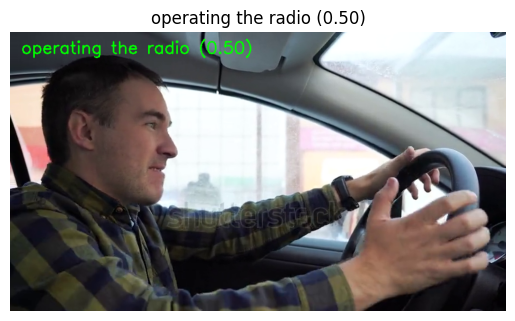


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.99, c3 0.00, c5 0.00, c7 0.00, c0 0.00, 80.5ms
Speed: 20.3ms preprocess, 80.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 60 → hair and makeup (0.99)


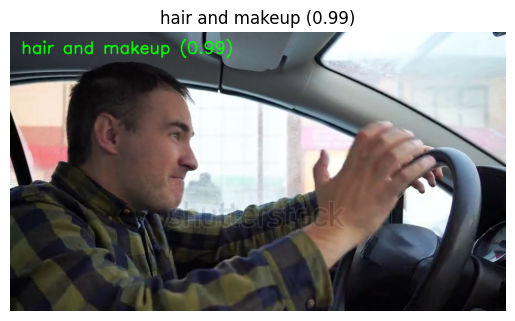


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.42, c8 0.42, c3 0.08, c9 0.05, c0 0.02, 68.8ms
Speed: 19.3ms preprocess, 68.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 65 → operating the radio (0.42)


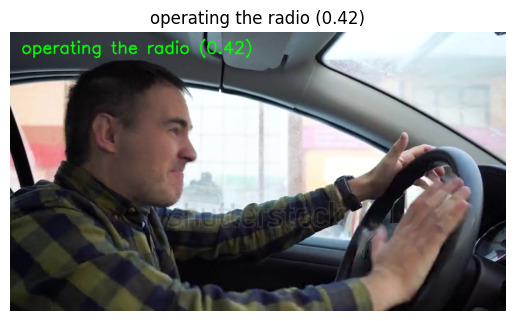


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 1.00, c3 0.00, c7 0.00, c5 0.00, c0 0.00, 95.7ms
Speed: 18.3ms preprocess, 95.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 70 → hair and makeup (1.00)


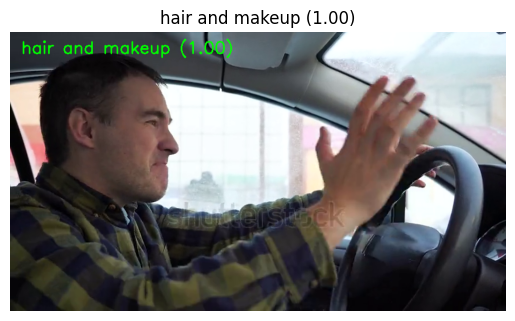


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 1.00, c5 0.00, c3 0.00, c7 0.00, c9 0.00, 69.6ms
Speed: 19.1ms preprocess, 69.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 75 → hair and makeup (1.00)


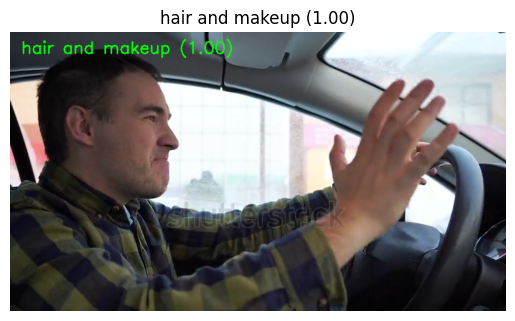


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.96, c3 0.02, c5 0.01, c9 0.00, c4 0.00, 84.4ms
Speed: 17.4ms preprocess, 84.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 80 → hair and makeup (0.96)


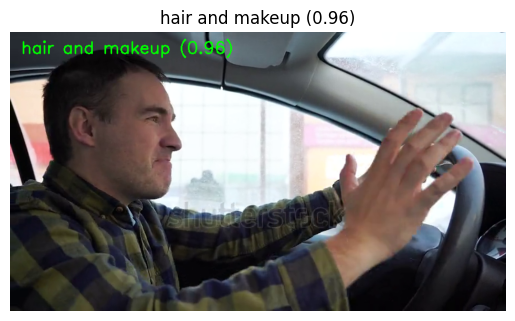


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.54, c5 0.38, c9 0.04, c3 0.02, c0 0.01, 71.4ms
Speed: 17.0ms preprocess, 71.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 85 → hair and makeup (0.54)


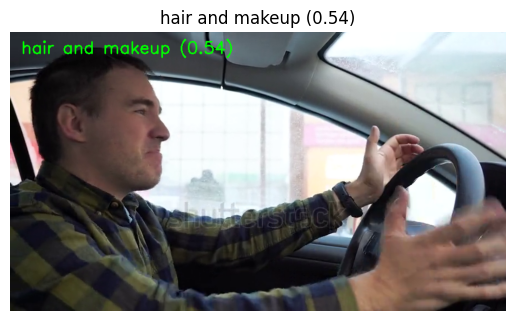


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.46, c9 0.25, c8 0.13, c3 0.12, c0 0.02, 76.8ms
Speed: 17.2ms preprocess, 76.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 90 → operating the radio (0.46)


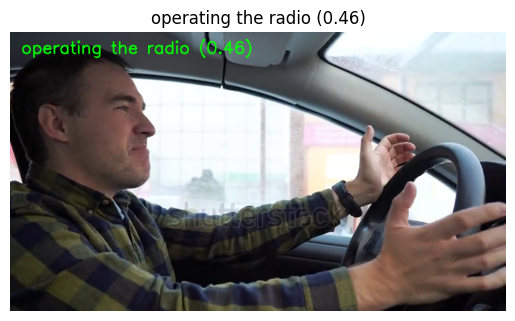


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.63, c8 0.14, c9 0.09, c3 0.08, c0 0.04, 72.6ms
Speed: 17.7ms preprocess, 72.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 95 → operating the radio (0.63)


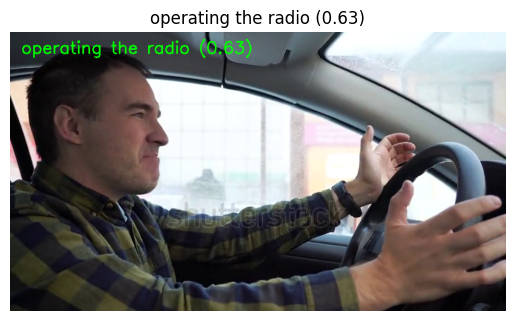


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.86, c3 0.06, c9 0.04, c8 0.03, c0 0.01, 91.9ms
Speed: 19.6ms preprocess, 91.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 100 → operating the radio (0.86)


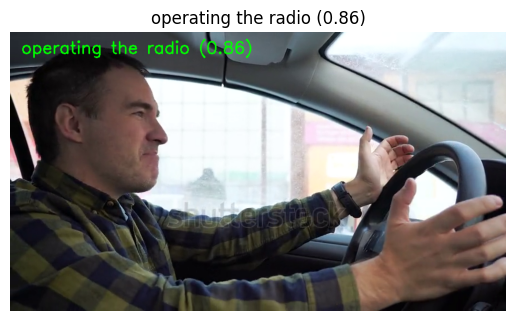


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.74, c9 0.12, c8 0.05, c3 0.05, c0 0.02, 79.8ms
Speed: 15.7ms preprocess, 79.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 105 → operating the radio (0.74)


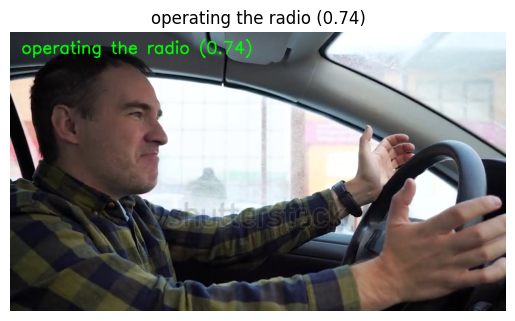


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.78, c9 0.09, c3 0.06, c8 0.04, c0 0.03, 94.3ms
Speed: 16.0ms preprocess, 94.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 110 → operating the radio (0.78)


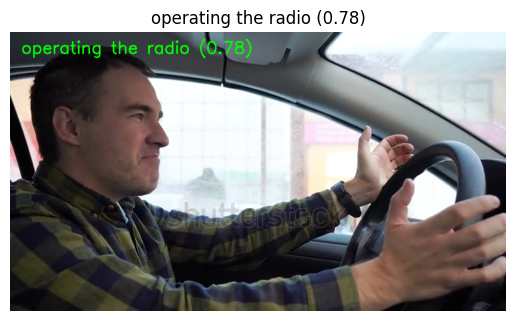


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.52, c8 0.21, c9 0.12, c3 0.11, c0 0.03, 69.3ms
Speed: 17.6ms preprocess, 69.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 115 → operating the radio (0.52)


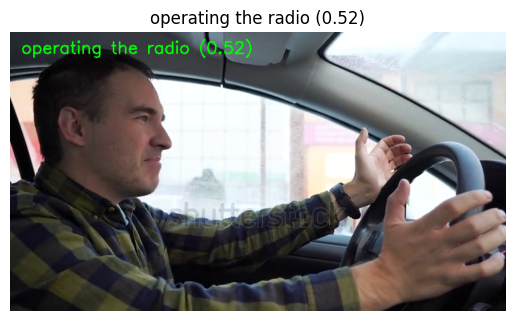


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.44, c9 0.27, c8 0.12, c3 0.10, c0 0.05, 76.4ms
Speed: 19.7ms preprocess, 76.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 120 → operating the radio (0.44)


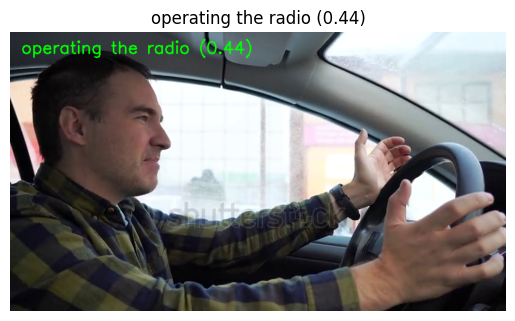


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.43, c3 0.19, c8 0.18, c9 0.15, c0 0.04, 68.1ms
Speed: 19.7ms preprocess, 68.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 125 → operating the radio (0.43)


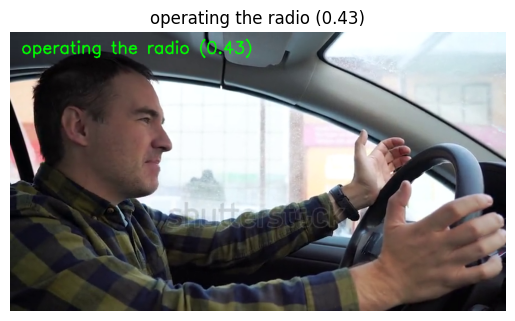


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.31, c5 0.27, c9 0.19, c3 0.16, c0 0.05, 68.6ms
Speed: 18.1ms preprocess, 68.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 130 → hair and makeup (0.31)


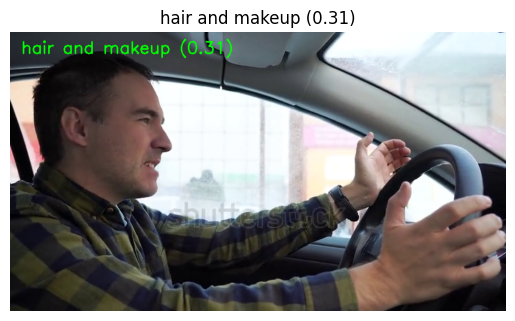


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.41, c5 0.32, c3 0.16, c9 0.08, c0 0.03, 84.1ms
Speed: 17.5ms preprocess, 84.1ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 135 → hair and makeup (0.41)


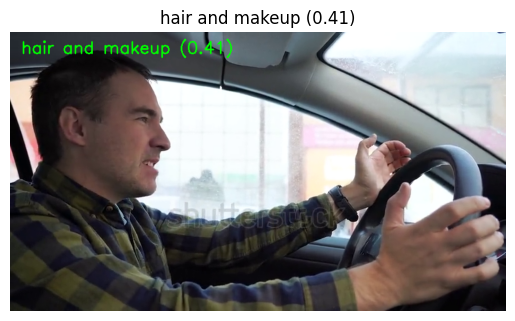


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.34, c8 0.31, c3 0.24, c9 0.04, c0 0.03, 73.4ms
Speed: 18.3ms preprocess, 73.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 140 → operating the radio (0.34)


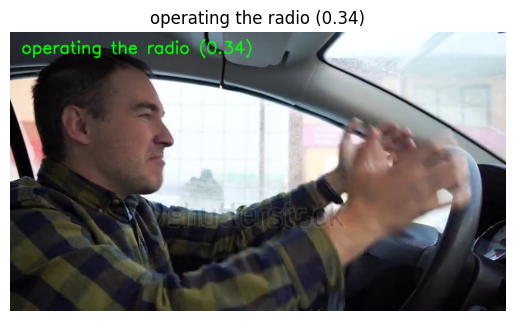


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.99, c3 0.00, c0 0.00, c5 0.00, c9 0.00, 70.3ms
Speed: 17.0ms preprocess, 70.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 145 → hair and makeup (0.99)


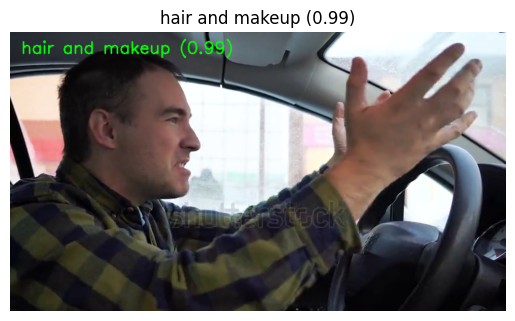


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.50, c8 0.26, c3 0.14, c9 0.04, c4 0.03, 62.1ms
Speed: 18.0ms preprocess, 62.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 150 → operating the radio (0.50)


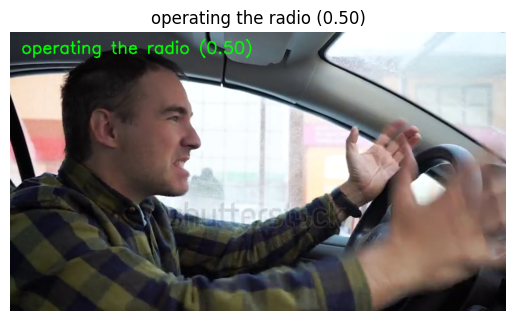


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c9 0.01, c3 0.01, c4 0.00, c0 0.00, 78.4ms
Speed: 17.3ms preprocess, 78.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 155 → operating the radio (0.98)


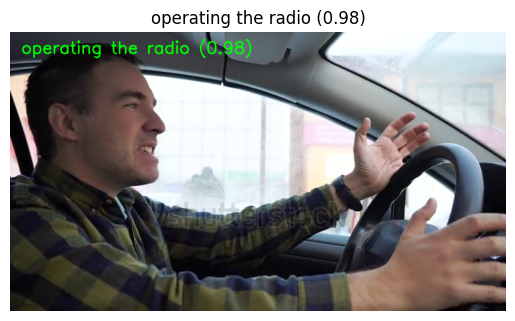


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.94, c3 0.03, c9 0.02, c4 0.00, c0 0.00, 75.5ms
Speed: 16.8ms preprocess, 75.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 160 → operating the radio (0.94)


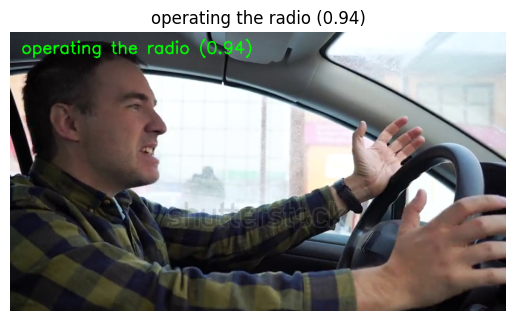


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.91, c9 0.05, c3 0.02, c4 0.01, c0 0.01, 88.1ms
Speed: 18.3ms preprocess, 88.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 165 → operating the radio (0.91)


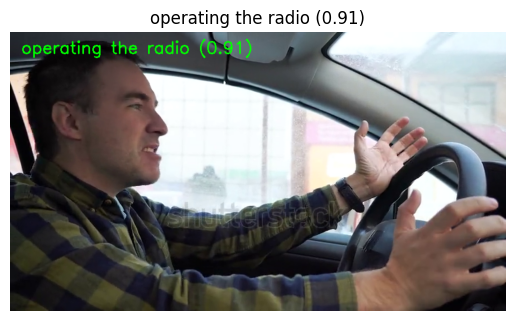


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.94, c9 0.04, c3 0.02, c8 0.00, c0 0.00, 79.3ms
Speed: 18.2ms preprocess, 79.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 170 → operating the radio (0.94)


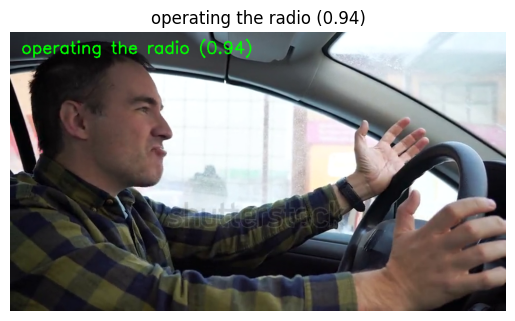


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.93, c9 0.06, c3 0.01, c0 0.00, c4 0.00, 70.3ms
Speed: 18.1ms preprocess, 70.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 175 → operating the radio (0.93)


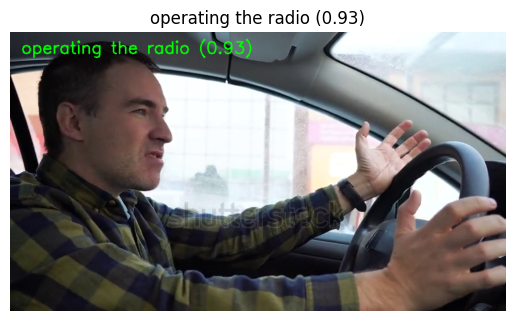


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.70, c9 0.27, c3 0.02, c0 0.01, c4 0.00, 68.3ms
Speed: 17.1ms preprocess, 68.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 180 → operating the radio (0.70)


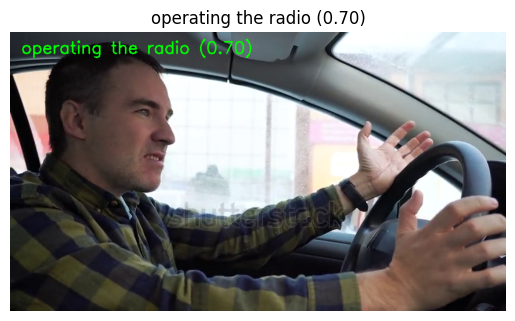


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.87, c9 0.12, c3 0.01, c0 0.00, c8 0.00, 67.2ms
Speed: 16.1ms preprocess, 67.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 185 → operating the radio (0.87)


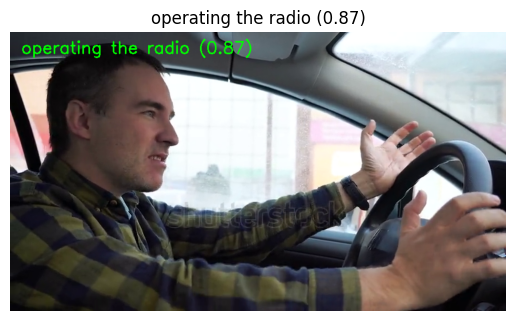


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.96, c9 0.03, c8 0.01, c0 0.00, c3 0.00, 53.7ms
Speed: 16.7ms preprocess, 53.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 190 → operating the radio (0.96)


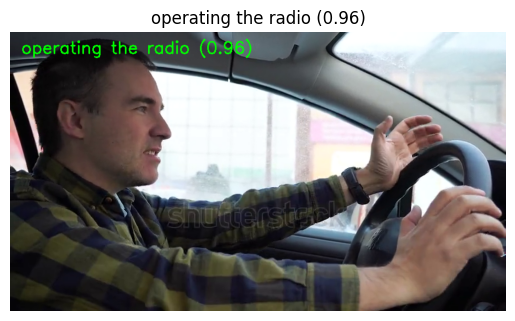


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c9 0.02, c8 0.00, c0 0.00, c3 0.00, 74.2ms
Speed: 16.7ms preprocess, 74.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 195 → operating the radio (0.98)


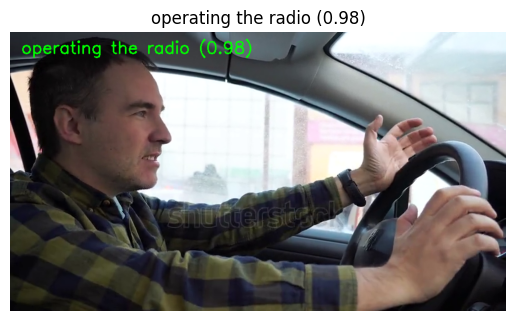


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.01, c8 0.00, c0 0.00, c3 0.00, 57.9ms
Speed: 15.9ms preprocess, 57.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 200 → operating the radio (0.99)


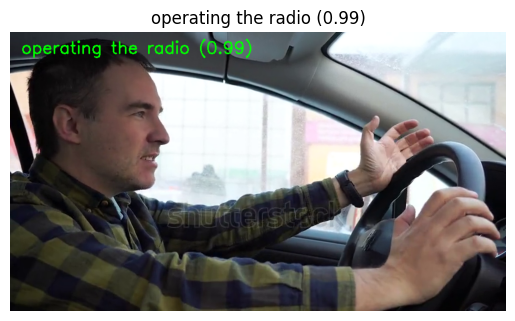


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c8 0.01, c3 0.00, c9 0.00, c0 0.00, 62.9ms
Speed: 17.6ms preprocess, 62.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 205 → operating the radio (0.98)


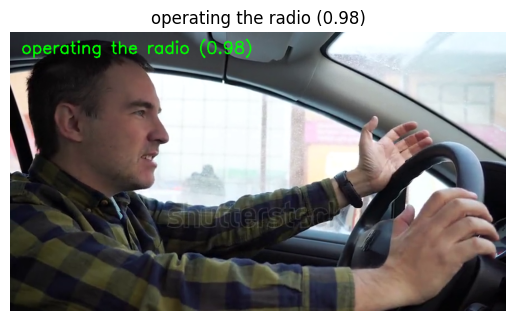


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 64.2ms
Speed: 17.2ms preprocess, 64.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 210 → operating the radio (0.99)


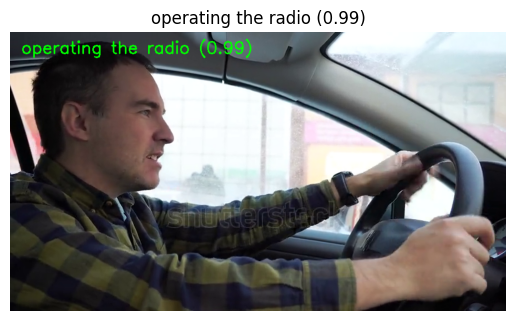


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 66.3ms
Speed: 17.4ms preprocess, 66.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 215 → operating the radio (0.99)


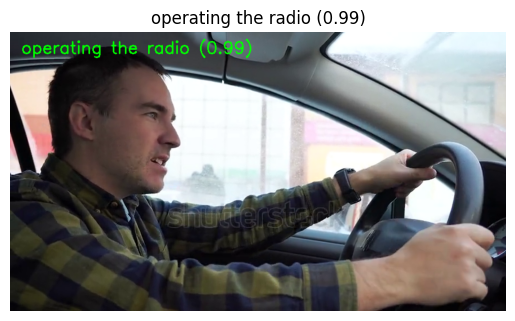


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 1.00, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 61.8ms
Speed: 13.6ms preprocess, 61.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 220 → operating the radio (1.00)


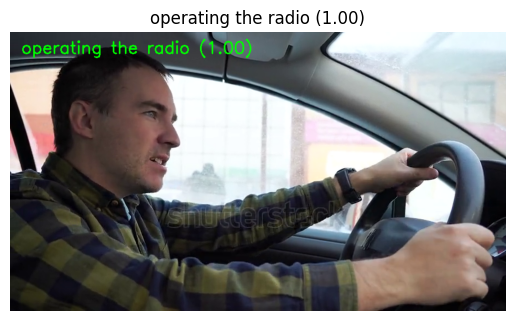


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 64.1ms
Speed: 18.1ms preprocess, 64.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 225 → operating the radio (0.99)


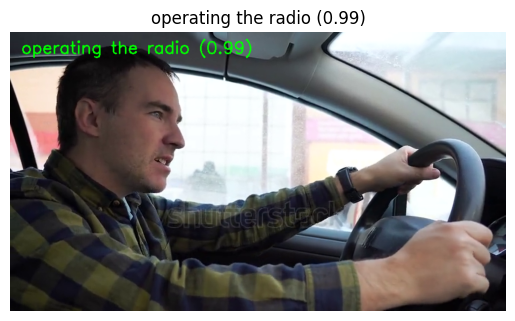


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 1.00, c0 0.00, c9 0.00, c3 0.00, c8 0.00, 71.3ms
Speed: 18.1ms preprocess, 71.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 230 → operating the radio (1.00)


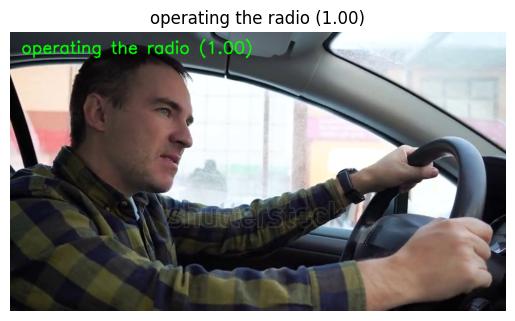


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 1.00, c0 0.00, c9 0.00, c3 0.00, c8 0.00, 72.7ms
Speed: 16.4ms preprocess, 72.7ms inference, 1.1ms postprocess per image at shape (1, 3, 224, 224)
Frame 235 → operating the radio (1.00)


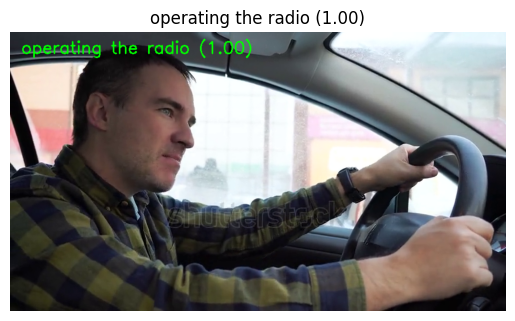


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c0 0.00, c9 0.00, c3 0.00, c8 0.00, 54.0ms
Speed: 18.2ms preprocess, 54.0ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 240 → operating the radio (0.99)


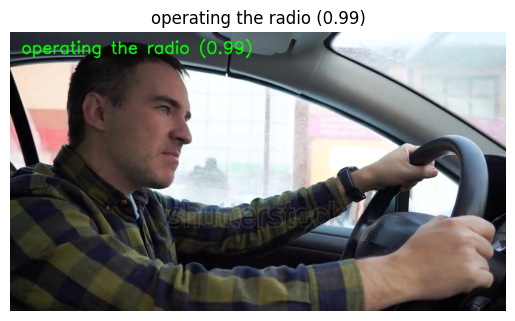


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c0 0.00, c9 0.00, c3 0.00, c8 0.00, 59.0ms
Speed: 18.8ms preprocess, 59.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 245 → operating the radio (0.99)


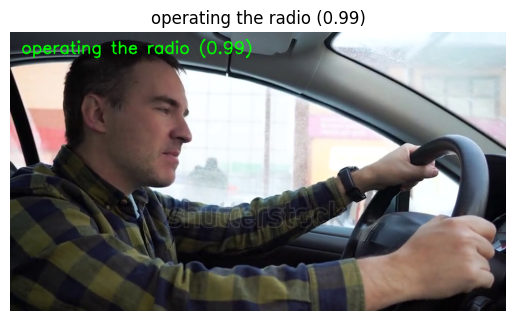


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c0 0.01, c9 0.01, c3 0.00, c8 0.00, 65.8ms
Speed: 16.8ms preprocess, 65.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 250 → operating the radio (0.98)


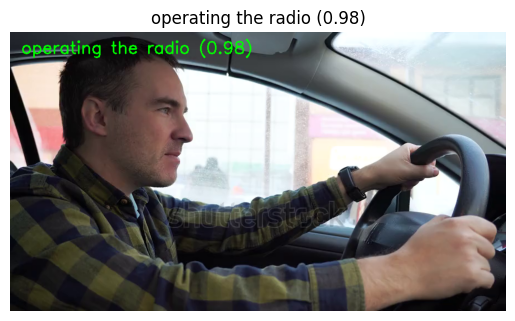


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 49.9ms
Speed: 14.5ms preprocess, 49.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 255 → operating the radio (0.99)


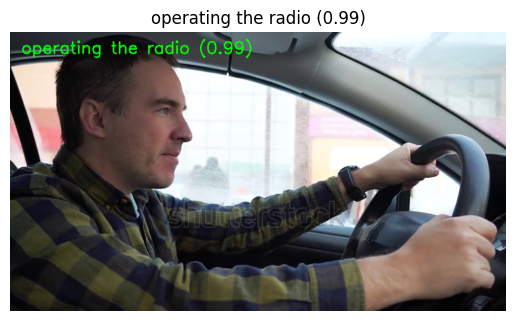


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c0 0.00, c9 0.00, c3 0.00, c8 0.00, 54.8ms
Speed: 15.1ms preprocess, 54.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 260 → operating the radio (0.99)


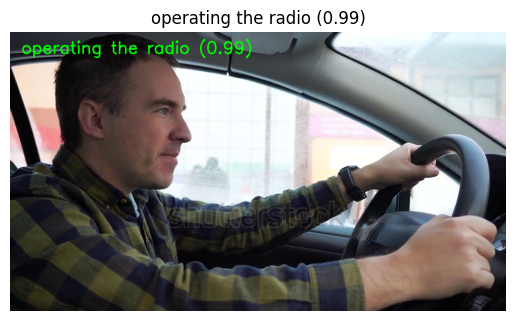


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c0 0.01, c9 0.00, c3 0.00, c8 0.00, 34.8ms
Speed: 11.7ms preprocess, 34.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 265 → operating the radio (0.99)


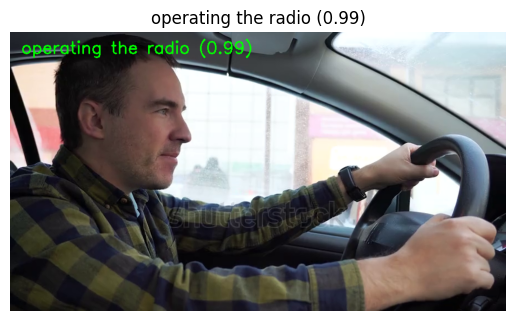


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.96, c0 0.02, c9 0.01, c3 0.01, c8 0.00, 53.8ms
Speed: 14.6ms preprocess, 53.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 270 → operating the radio (0.96)


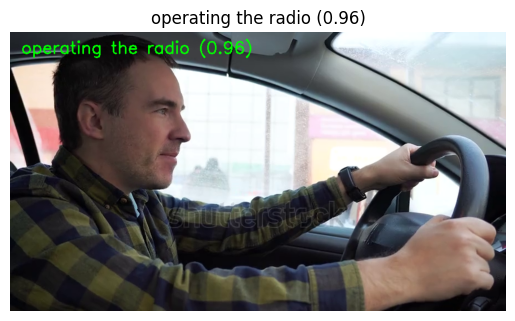


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c0 0.01, c9 0.01, c3 0.00, c8 0.00, 72.0ms
Speed: 20.7ms preprocess, 72.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 275 → operating the radio (0.98)


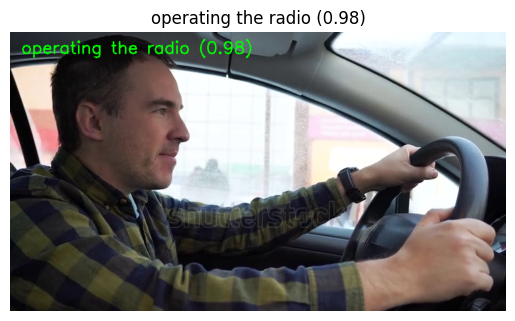


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.01, c0 0.00, c3 0.00, c8 0.00, 37.3ms
Speed: 9.9ms preprocess, 37.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 280 → operating the radio (0.99)


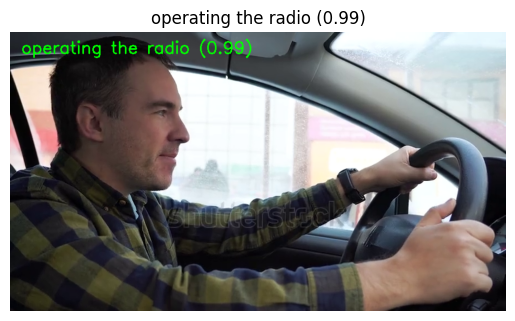


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.99, c9 0.00, c0 0.00, c3 0.00, c8 0.00, 68.4ms
Speed: 17.9ms preprocess, 68.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 285 → operating the radio (0.99)


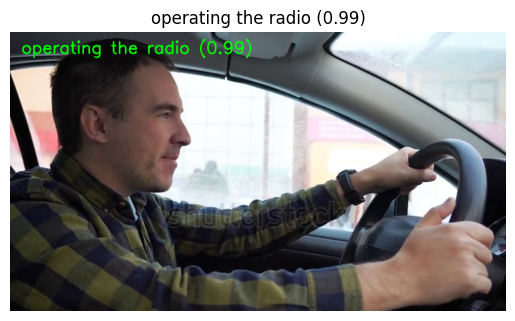


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.98, c9 0.01, c0 0.01, c3 0.00, c8 0.00, 67.4ms
Speed: 15.8ms preprocess, 67.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 290 → operating the radio (0.98)


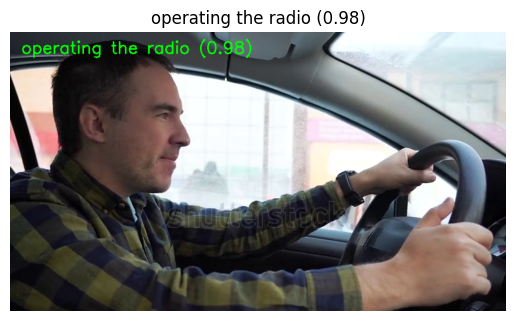


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.95, c9 0.04, c0 0.01, c3 0.00, c8 0.00, 66.6ms
Speed: 18.4ms preprocess, 66.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 295 → operating the radio (0.95)


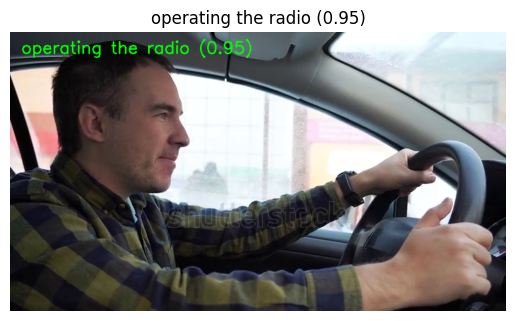


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.92, c9 0.06, c0 0.01, c8 0.01, c3 0.01, 84.6ms
Speed: 18.2ms preprocess, 84.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 300 → operating the radio (0.92)


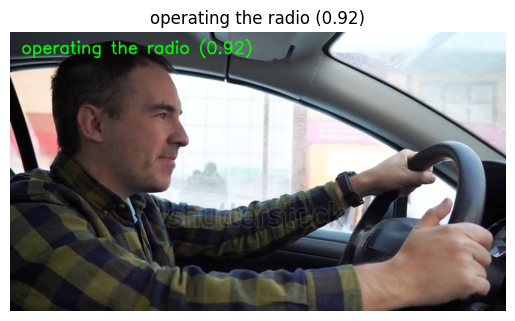


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.65, c9 0.17, c3 0.07, c8 0.06, c0 0.04, 73.9ms
Speed: 15.6ms preprocess, 73.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 305 → operating the radio (0.65)


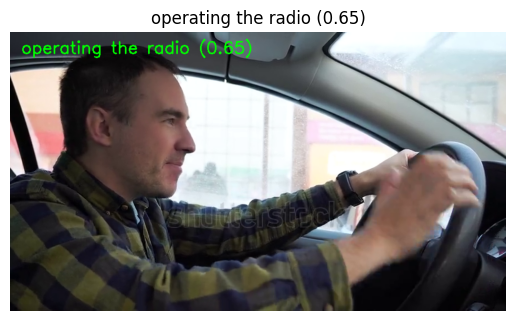


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.85, c8 0.04, c9 0.04, c3 0.04, c0 0.02, 67.1ms
Speed: 18.6ms preprocess, 67.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 310 → operating the radio (0.85)


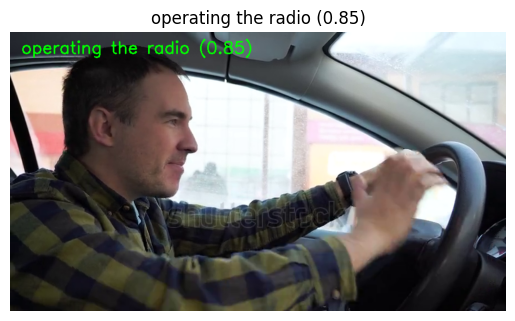


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.98, c0 0.01, c9 0.01, c3 0.00, c5 0.00, 76.3ms
Speed: 18.1ms preprocess, 76.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 315 → hair and makeup (0.98)


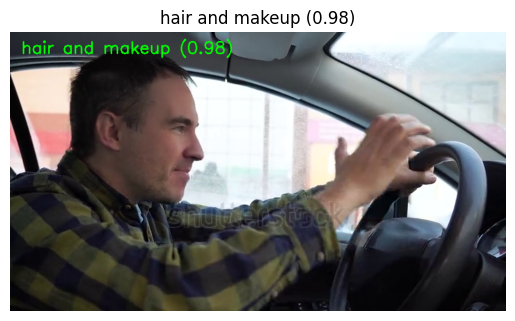


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.83, c9 0.07, c3 0.04, c8 0.03, c0 0.02, 67.8ms
Speed: 16.9ms preprocess, 67.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 320 → operating the radio (0.83)


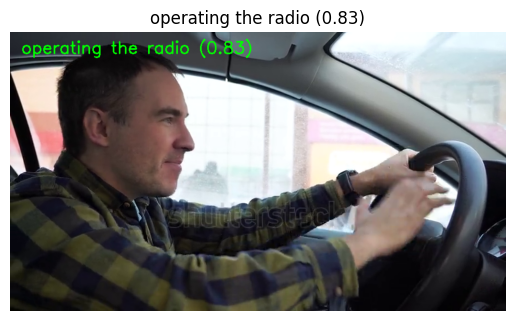


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.54, c5 0.30, c9 0.06, c0 0.05, c3 0.03, 64.7ms
Speed: 17.1ms preprocess, 64.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 325 → hair and makeup (0.54)


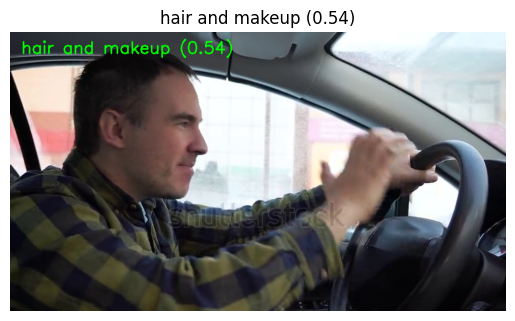


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.43, c5 0.27, c3 0.09, c9 0.08, c0 0.07, 61.9ms
Speed: 16.1ms preprocess, 61.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 330 → hair and makeup (0.43)


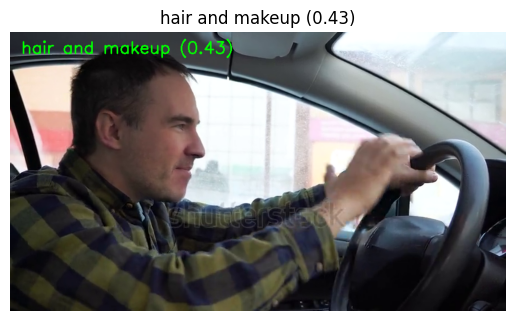


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.94, c9 0.02, c0 0.01, c8 0.01, c3 0.01, 72.2ms
Speed: 18.1ms preprocess, 72.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 335 → operating the radio (0.94)


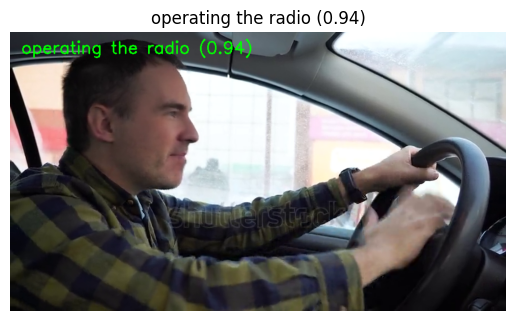


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c8 0.39, c9 0.28, c3 0.14, c5 0.13, c0 0.04, 65.7ms
Speed: 18.2ms preprocess, 65.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 340 → hair and makeup (0.39)


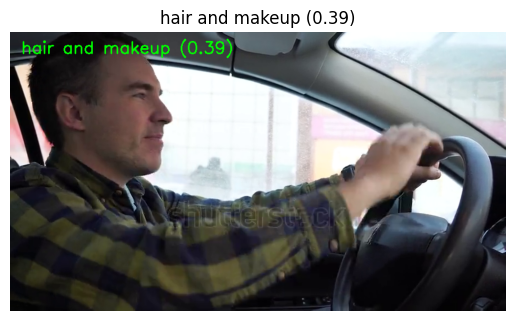


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.36, c9 0.23, c3 0.19, c8 0.11, c0 0.08, 61.6ms
Speed: 20.4ms preprocess, 61.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 345 → operating the radio (0.36)


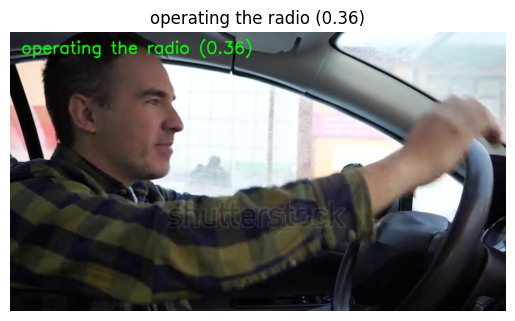


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.94, c3 0.04, c0 0.01, c8 0.01, c9 0.01, 58.5ms
Speed: 17.1ms preprocess, 58.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 350 → operating the radio (0.94)


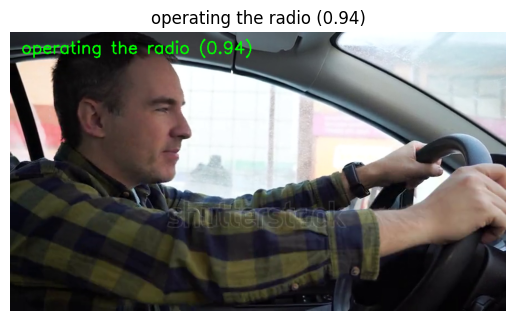


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.92, c3 0.05, c8 0.02, c0 0.01, c9 0.00, 75.6ms
Speed: 18.1ms preprocess, 75.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 355 → operating the radio (0.92)


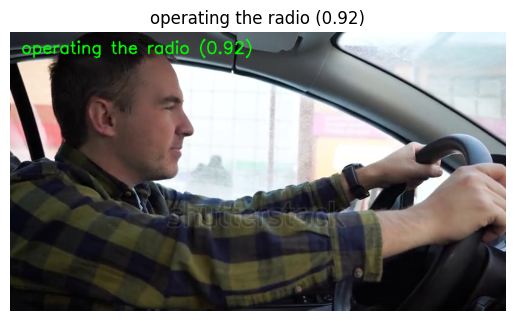


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.91, c3 0.05, c8 0.03, c9 0.01, c0 0.01, 68.5ms
Speed: 16.7ms preprocess, 68.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 360 → operating the radio (0.91)


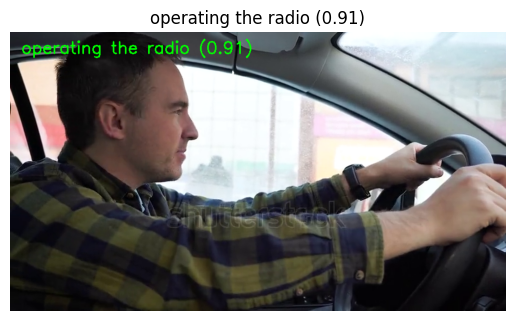


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.88, c3 0.07, c0 0.02, c8 0.01, c9 0.01, 62.2ms
Speed: 17.1ms preprocess, 62.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 365 → operating the radio (0.88)


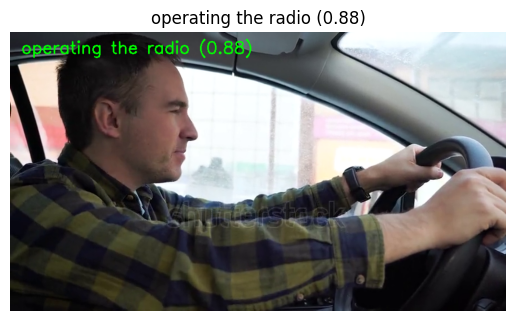


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.77, c3 0.11, c0 0.07, c9 0.03, c8 0.01, 66.0ms
Speed: 16.3ms preprocess, 66.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 370 → operating the radio (0.77)


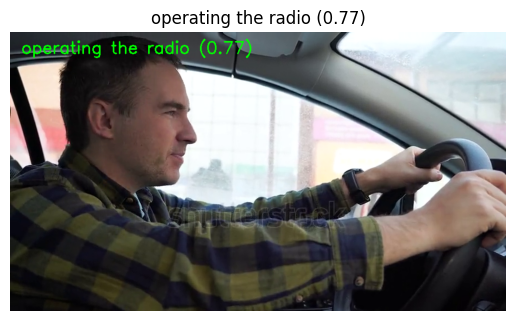


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.88, c3 0.05, c0 0.03, c8 0.02, c9 0.01, 69.2ms
Speed: 17.1ms preprocess, 69.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 375 → operating the radio (0.88)


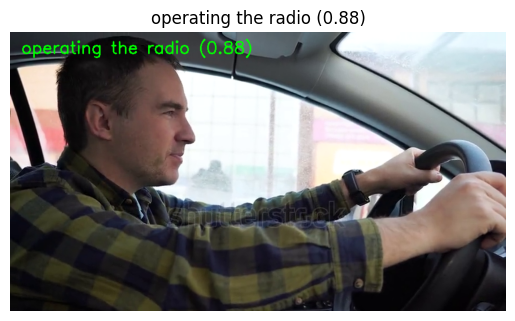


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.73, c3 0.14, c0 0.06, c8 0.04, c9 0.03, 56.1ms
Speed: 15.6ms preprocess, 56.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 380 → operating the radio (0.73)


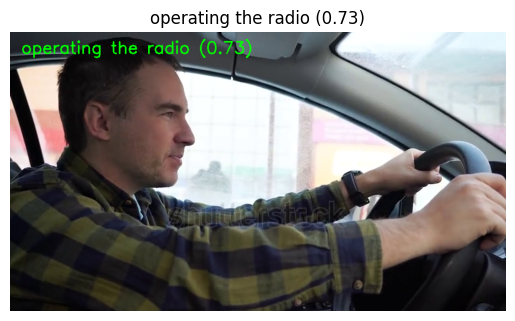


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.88, c3 0.06, c0 0.03, c9 0.02, c8 0.00, 67.4ms
Speed: 18.1ms preprocess, 67.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 385 → operating the radio (0.88)


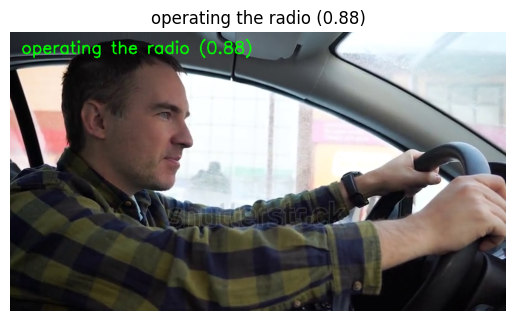


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.92, c3 0.05, c0 0.02, c9 0.01, c8 0.01, 74.4ms
Speed: 18.6ms preprocess, 74.4ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 390 → operating the radio (0.92)


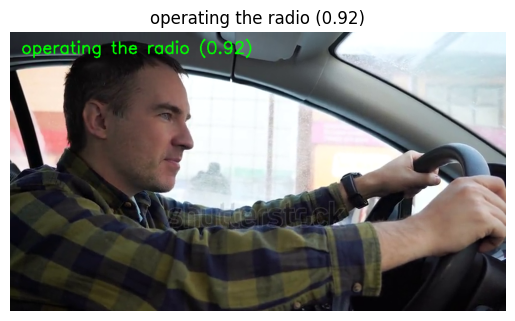


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.92, c3 0.04, c0 0.01, c8 0.01, c9 0.01, 76.3ms
Speed: 19.8ms preprocess, 76.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 395 → operating the radio (0.92)


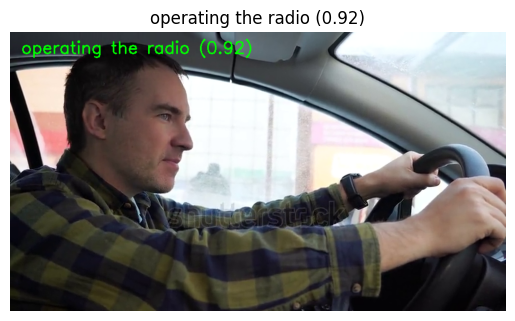


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.93, c3 0.04, c8 0.01, c0 0.01, c9 0.01, 73.3ms
Speed: 19.6ms preprocess, 73.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 400 → operating the radio (0.93)


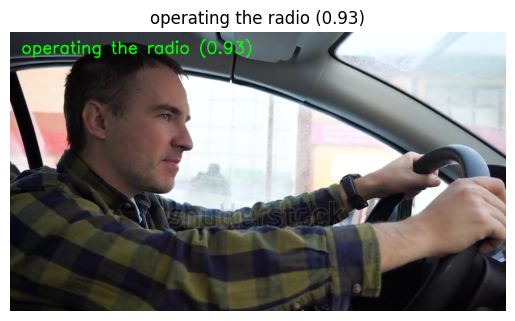


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c5 0.91, c3 0.05, c0 0.02, c9 0.01, c8 0.01, 73.9ms
Speed: 17.2ms preprocess, 73.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 405 → operating the radio (0.91)


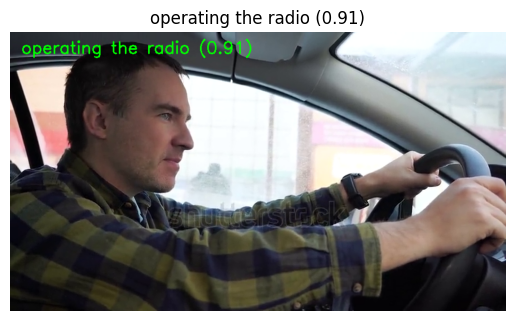

In [5]:
import cv2
from ultralytics import YOLO
import os
import matplotlib.pyplot as plt
# Load trained YOLOv8 classification model
model = YOLO(r"C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\DriverAlert/best.pt")

# Descriptive class names
classes = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',    # c2
    'texting - left',                  # c3
    'talking on the phone - left',     # c4
    'operating the radio',             # c5
    'drinking',                        # c6
    'reaching behind',                 # c7
    'hair and makeup',                 # c8
    'talking to passenger'             # c9
]

# Function to predict on video
def predict_video(video_path, frame_skip=5, show=True):
    cap = cv2.VideoCapture(video_path)
    frame_id = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_id % frame_skip == 0:
            frame_path = "temp_frame.jpg"
            cv2.imwrite(frame_path, frame)

            result = model(frame_path)[0]
            class_index = result.probs.top1
            class_name = classes[class_index]
            confidence = result.probs.top1conf

            label = f"{class_name} ({confidence:.2f})"
            print(f"Frame {frame_id} → {label}")

            if show:
                annotated = frame.copy()
                cv2.putText(annotated, label, (20, 40), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
                rgb_frame = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
                plt.imshow(rgb_frame)
                plt.title(label)
                plt.axis('off')
                plt.show()

        frame_id += 1

    cap.release()


# Example usage
predict_video(r"C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\DriverAlert\static\uploads/WhatsApp Video 2025-03-29 at 12.16.19.mp4")  # Replace with your video path


1/1 [==============================] - 0s 153ms/step


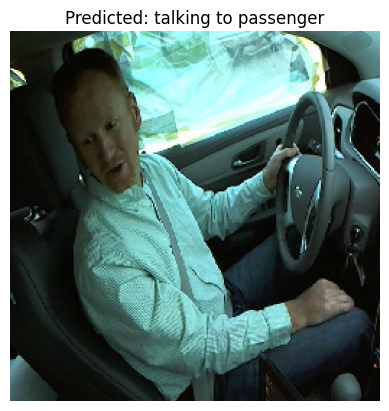

Predicted class: talking to passenger


In [6]:
import tensorflow as tf
import numpy as np
from tensorflow.keras.preprocessing import image
from tensorflow.keras.models import load_model
import matplotlib.pyplot as plt
import os
model = load_model(r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes/vggmodel.h5')
class_labels  = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',    # c2
    'texting - left',                  # c3
    'talking on the phone - left',     # c4
    'operating the radio',             # c5
    'drinking',                        # c6
    'reaching behind',                 # c7
    'hair and makeup',                 # c8
    'talking to passenger'             # c9
]
def predict_image(image_path, model, class_labels):
    # Load and preprocess the image
    img = image.load_img(image_path, target_size=(256, 256))
    img_array = image.img_to_array(img)
    img_array = img_array / 255.0  # Normalize
    img_array = np.expand_dims(img_array, axis=0)  # Make batch of 1

    # Predict
    predictions = model.predict(img_array)
    predicted_class = np.argmax(predictions, axis=1)[0]

    # Display image and prediction
    plt.imshow(img)
    plt.axis('off')
    plt.title(f"Predicted: {class_labels[predicted_class]}")
    plt.show()

    return class_labels[predicted_class]
image_path = r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\state-farm-distracted-driver-detection\imgs\test/img_746.jpg'
predicted_label = predict_image(image_path, model, class_labels)
print("Predicted class:", predicted_label)



In [9]:
import cv2
import tensorflow as tf
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array
import time

# Load the trained model
model = load_model(r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes/vggmodel.h5')

# Define class labels
class_labels  = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',    # c2
    'texting - left',                  # c3
    'talking on the phone - left',     # c4
    'operating the radio',             # c5
    'drinking',                        # c6
    'reaching behind',                 # c7
    'hair and makeup',                 # c8
    'talking to passenger'             # c9
]

# Load video file (or use 0 for webcam)
video_path = r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\abcd.mp4'  # Replace with your video path
cap = cv2.VideoCapture(0)

# Loop through frames
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break  # End of video
    
    # Preprocess the frame for model
    frame_resized = cv2.resize(frame, (256, 256))
    frame_array = img_to_array(frame_resized) / 255.0
    frame_array = np.expand_dims(frame_array, axis=0)

    # Predict
    predictions = model.predict(frame_array, verbose=0)
    predicted_class = np.argmax(predictions, axis=1)[0]
    predicted_label = class_labels[predicted_class]

    # Show prediction on the frame
    cv2.putText(frame, f"Prediction: {predicted_label}", (10, 40), 
                cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 3)

    # Display frame
    cv2.imshow('Driver Behavior Detection', frame)

    # Exit on pressing 'q'
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Cleanup
cap.release()
cv2.destroyAllWindows()


In [1]:
import cv2
import tensorflow as tf
import numpy as np
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array

# Load the trained model
model = load_model(r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes/vggmodel.h5')

# Define class labels
class_labels  = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',    # c2
    'texting - left',                  # c3
    'talking on the phone - left',     # c4
    'operating the radio',             # c5
    'drinking',                        # c6
    'reaching behind',                 # c7
    'hair and makeup',                 # c8
    'talking to passenger'             # c9
]

# Load video file (or webcam: use 0)
video_path = r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\abcd.mp4'
cap = cv2.VideoCapture(video_path)

# Get video properties
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))

# Define VideoWriter to save the output video
output_path = r'C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\output.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for .mp4
out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

# Loop through video frames
while cap.isOpened():
    ret, frame = cap.read()
    if not ret:
        break

    # Preprocess the frame for model
    resized = cv2.resize(frame, (256, 256))
    img_array = img_to_array(resized) / 255.0
    img_array = np.expand_dims(img_array, axis=0)

    # Prediction
    predictions = model.predict(img_array, verbose=0)
    predicted_class = np.argmax(predictions, axis=1)[0]
    predicted_label = class_labels[predicted_class]

    # Add prediction text to frame
    cv2.putText(frame, f"Prediction: {predicted_label}", (10, 40),
                cv2.FONT_HERSHEY_SIMPLEX, 1.2, (0, 255, 0), 3)

    # Write frame to output video
    out.write(frame)

    # Display the frame
    cv2.imshow('Driver Behavior Detection', frame)

    # Press 'q' to stop early
    if cv2.waitKey(1) & 0xFF == ord('q'):
        break

# Cleanup
cap.release()
out.release()
cv2.destroyAllWindows()

print(f"✅ Prediction video saved at: {output_path}")


✅ Prediction video saved at: C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes\output.mp4



image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 1.00, c9 0.00, c5 0.00, c8 0.00, c1 0.00, 116.6ms
Speed: 13.5ms preprocess, 116.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 0 → safe driving (1.00)


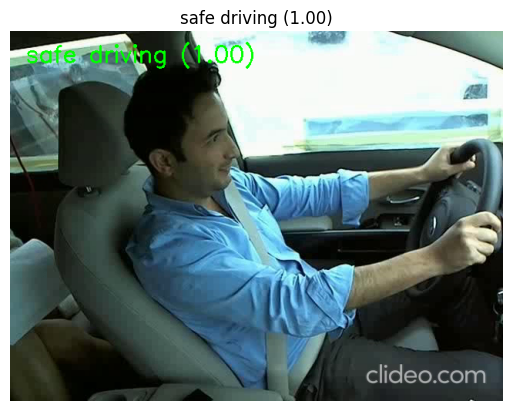


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 0.97, c9 0.02, c1 0.00, c5 0.00, c2 0.00, 67.7ms
Speed: 15.0ms preprocess, 67.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 5 → safe driving (0.97)


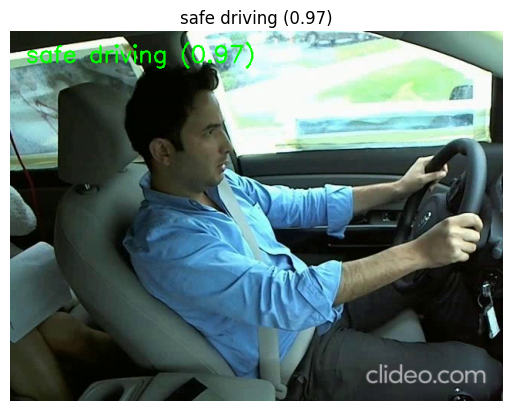


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 0.96, c9 0.04, c5 0.00, c8 0.00, c2 0.00, 89.6ms
Speed: 17.0ms preprocess, 89.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 10 → safe driving (0.96)


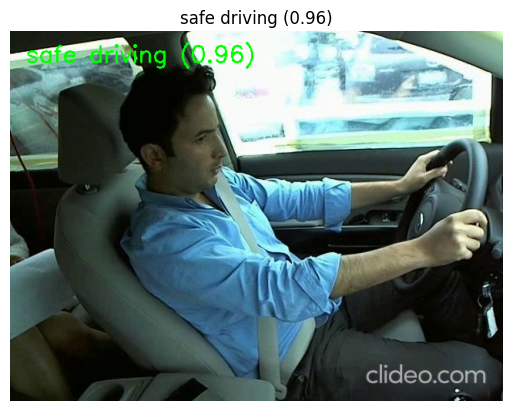


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 1.00, c9 0.00, c8 0.00, c2 0.00, c1 0.00, 88.0ms
Speed: 14.9ms preprocess, 88.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 15 → safe driving (1.00)


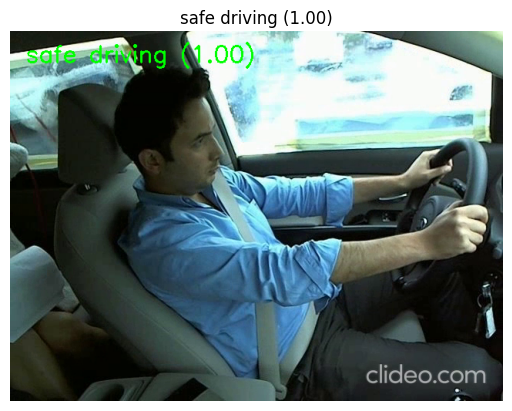


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c2 0.00, c5 0.00, c8 0.00, 98.7ms
Speed: 15.8ms preprocess, 98.7ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 20 → texting - right (1.00)


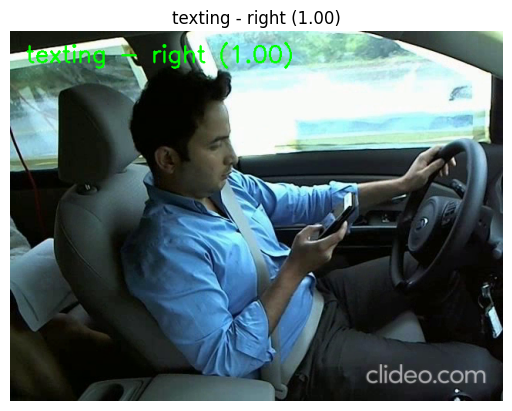


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c2 0.00, c5 0.00, c8 0.00, 77.1ms
Speed: 14.3ms preprocess, 77.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 25 → texting - right (1.00)


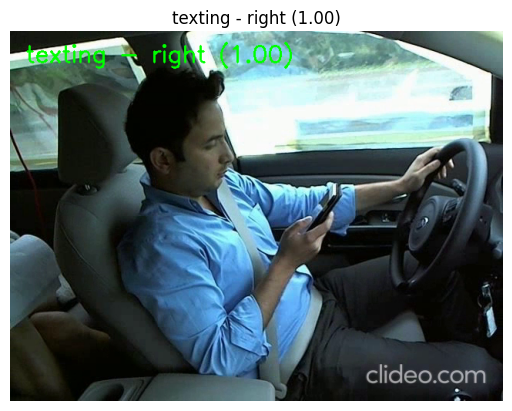


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c5 0.00, c2 0.00, c9 0.00, 103.7ms
Speed: 14.1ms preprocess, 103.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 30 → texting - right (1.00)


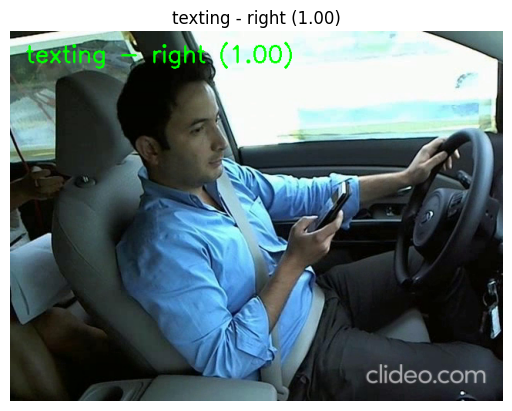


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c2 0.00, c5 0.00, c8 0.00, 90.4ms
Speed: 14.0ms preprocess, 90.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 35 → texting - right (1.00)


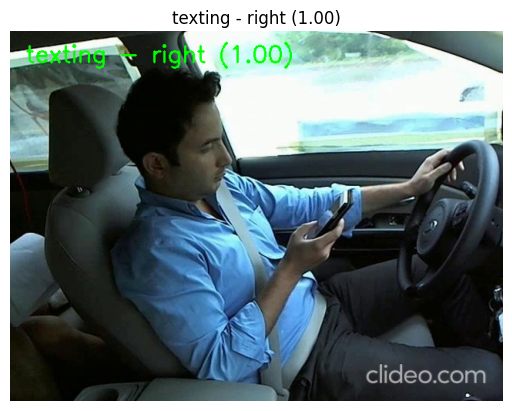


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c2 0.00, c5 0.00, c8 0.00, 72.8ms
Speed: 15.0ms preprocess, 72.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 40 → texting - right (1.00)


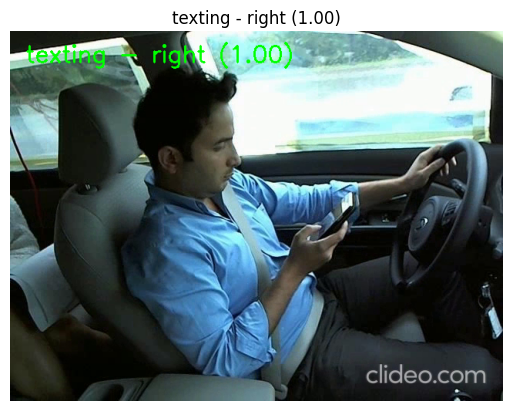


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c8 0.00, c9 0.00, c5 0.00, 80.6ms
Speed: 16.2ms preprocess, 80.6ms inference, 1.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 45 → texting - right (1.00)


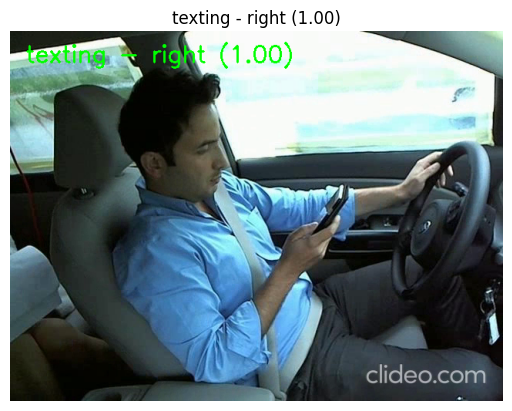


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c5 0.00, c3 0.00, c2 0.00, 80.4ms
Speed: 16.5ms preprocess, 80.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 50 → texting - right (1.00)


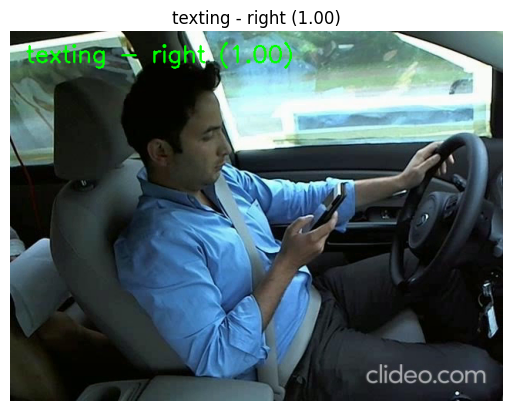


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c2 0.00, c6 0.00, c5 0.00, c3 0.00, 71.6ms
Speed: 15.0ms preprocess, 71.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 55 → texting - right (1.00)


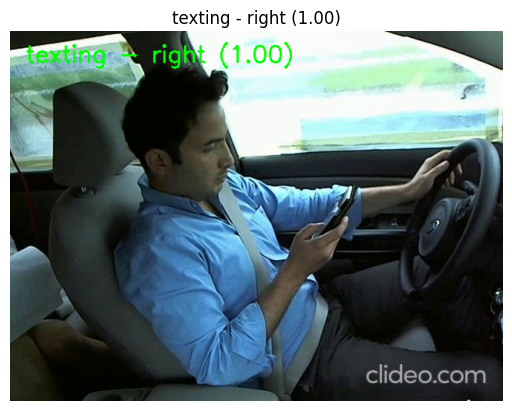


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c8 0.00, c2 0.00, c5 0.00, 87.4ms
Speed: 15.9ms preprocess, 87.4ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 60 → texting - right (1.00)


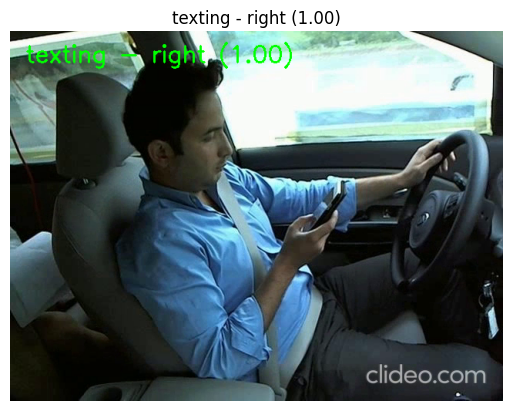


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c8 0.00, c0 0.00, c9 0.00, 107.7ms
Speed: 14.9ms preprocess, 107.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 65 → texting - right (1.00)


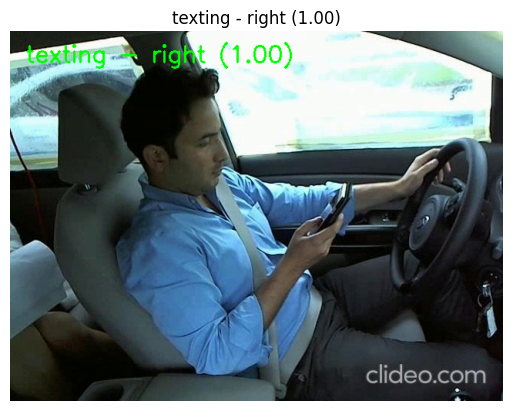


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c5 0.00, c2 0.00, c8 0.00, 95.6ms
Speed: 14.0ms preprocess, 95.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 70 → texting - right (1.00)


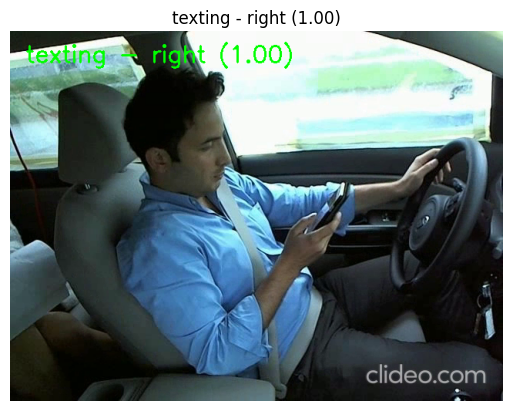


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c1 1.00, c6 0.00, c2 0.00, c8 0.00, c5 0.00, 90.9ms
Speed: 15.1ms preprocess, 90.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 75 → texting - right (1.00)


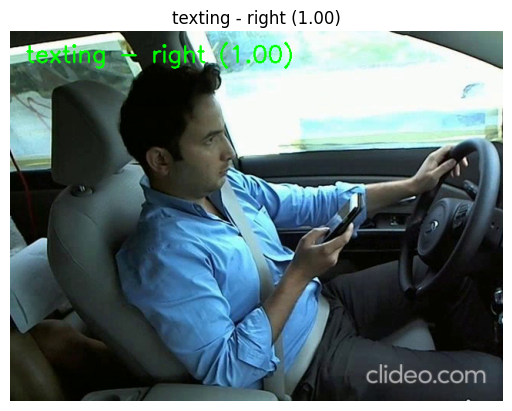


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 0.99, c9 0.00, c1 0.00, c8 0.00, c2 0.00, 106.1ms
Speed: 19.0ms preprocess, 106.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 80 → safe driving (0.99)


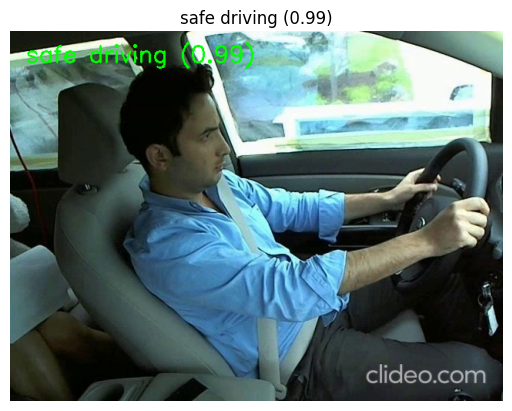


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c8 0.00, c1 0.00, c9 0.00, c6 0.00, 83.9ms
Speed: 16.0ms preprocess, 83.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 85 → talking on the phone - right (1.00)


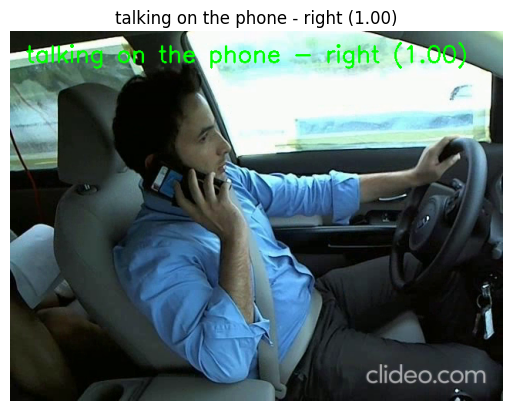


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c8 0.00, c1 0.00, c6 0.00, c5 0.00, 96.5ms
Speed: 13.0ms preprocess, 96.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 90 → talking on the phone - right (1.00)


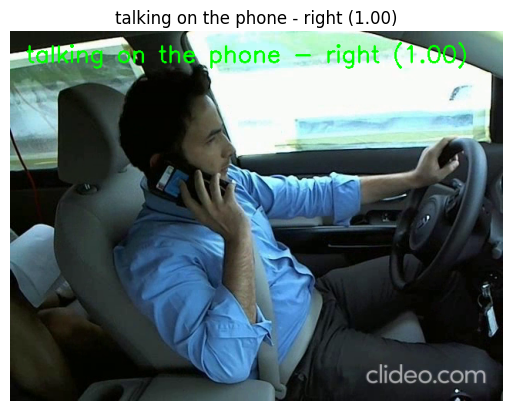


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c1 0.00, c8 0.00, c6 0.00, c5 0.00, 73.6ms
Speed: 13.9ms preprocess, 73.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 95 → talking on the phone - right (1.00)


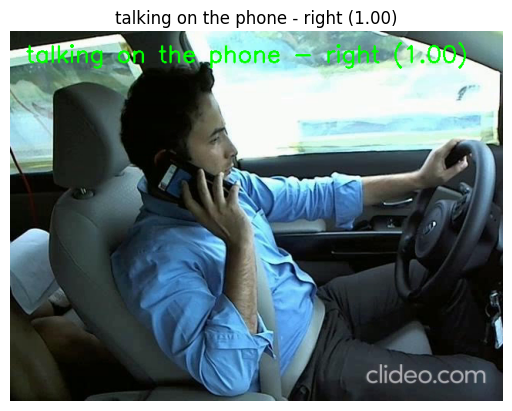


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c8 0.00, c1 0.00, c6 0.00, c9 0.00, 76.2ms
Speed: 15.0ms preprocess, 76.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 100 → talking on the phone - right (1.00)


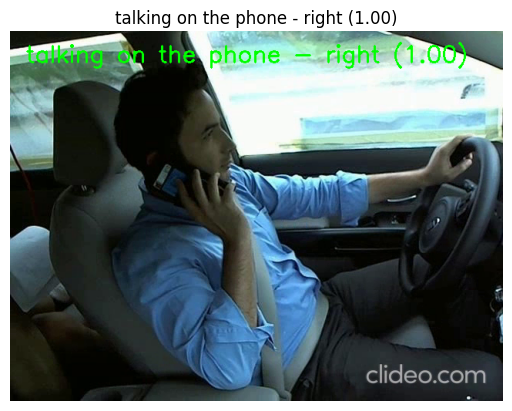


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c1 0.00, c6 0.00, c8 0.00, c5 0.00, 80.6ms
Speed: 15.0ms preprocess, 80.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 105 → talking on the phone - right (1.00)


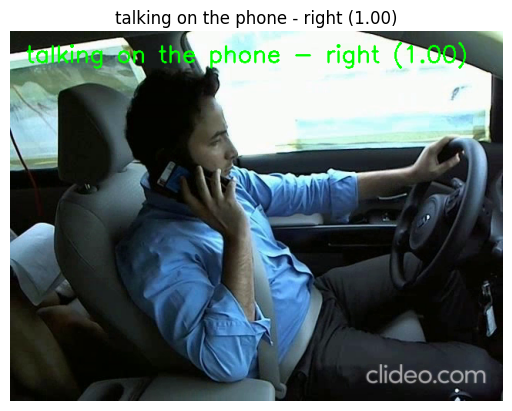


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c2 1.00, c8 0.00, c1 0.00, c6 0.00, c9 0.00, 89.5ms
Speed: 14.1ms preprocess, 89.5ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 110 → talking on the phone - right (1.00)


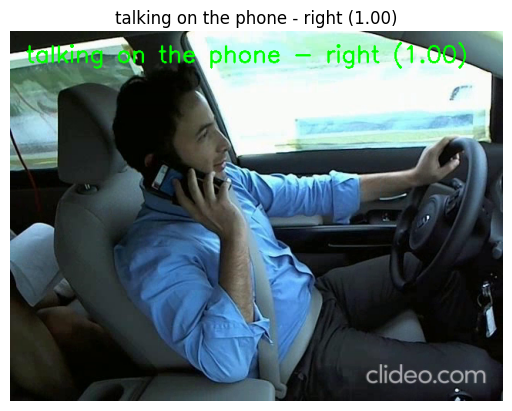


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c4 0.00, c0 0.00, c5 0.00, c9 0.00, 60.8ms
Speed: 13.0ms preprocess, 60.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 115 → texting - left (1.00)


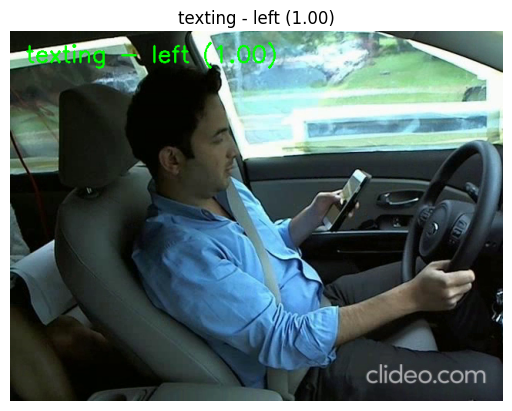


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c5 0.00, c9 0.00, c0 0.00, c4 0.00, 115.7ms
Speed: 14.7ms preprocess, 115.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 120 → texting - left (1.00)


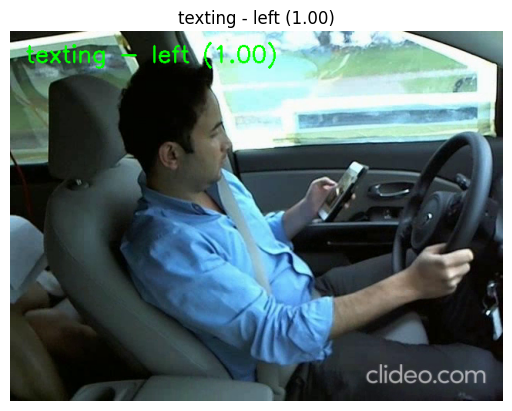


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c0 0.00, c1 0.00, c5 0.00, c9 0.00, 71.0ms
Speed: 13.7ms preprocess, 71.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 125 → texting - left (1.00)


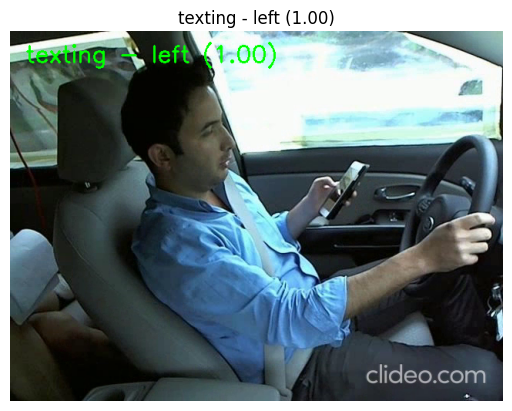


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c0 0.00, c4 0.00, c5 0.00, c9 0.00, 65.6ms
Speed: 13.2ms preprocess, 65.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 130 → texting - left (1.00)


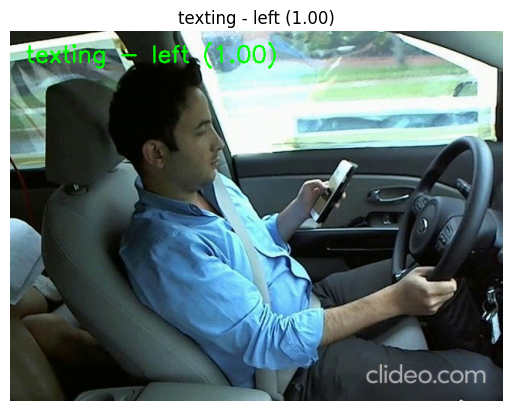


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c5 0.00, c9 0.00, c0 0.00, c1 0.00, 71.7ms
Speed: 14.9ms preprocess, 71.7ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 135 → texting - left (1.00)


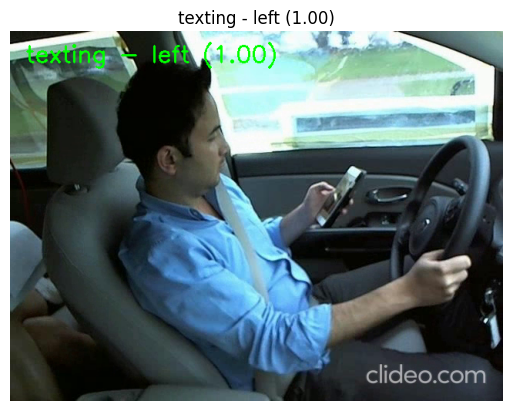


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c5 0.00, c9 0.00, c1 0.00, c4 0.00, 67.6ms
Speed: 15.0ms preprocess, 67.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 140 → texting - left (1.00)


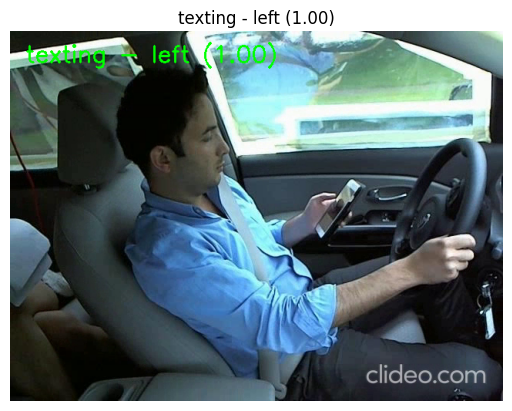


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c4 0.00, c5 0.00, c1 0.00, c6 0.00, 63.1ms
Speed: 15.2ms preprocess, 63.1ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 145 → texting - left (1.00)


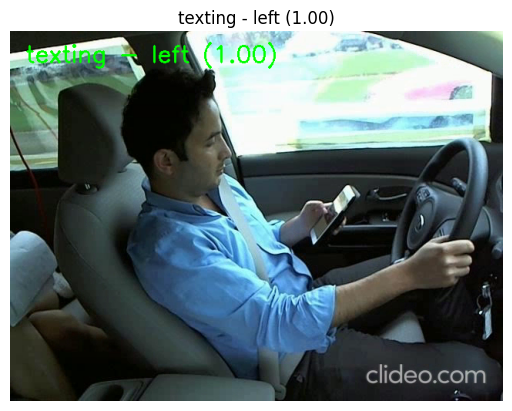


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c3 1.00, c9 0.00, c4 0.00, c1 0.00, c0 0.00, 64.0ms
Speed: 14.0ms preprocess, 64.0ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 150 → texting - left (1.00)


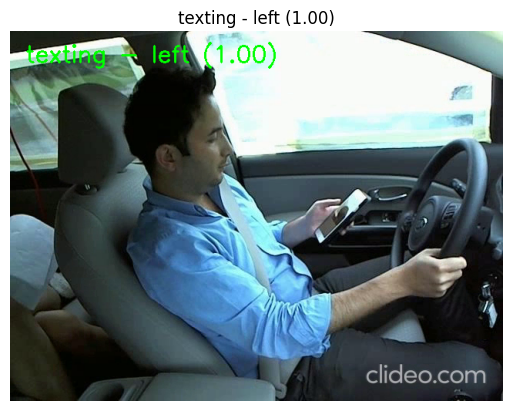


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 0.99, c9 0.01, c5 0.00, c8 0.00, c2 0.00, 78.6ms
Speed: 14.9ms preprocess, 78.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 155 → safe driving (0.99)


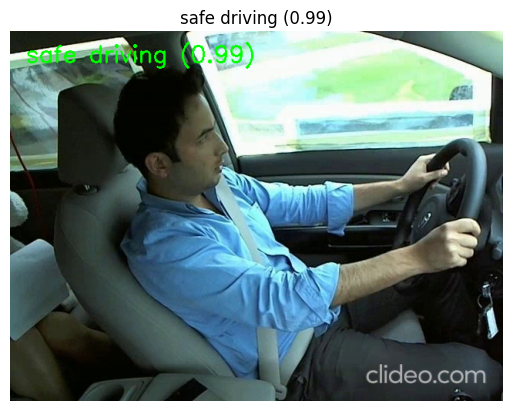


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c0 1.00, c9 0.00, c1 0.00, c5 0.00, c2 0.00, 86.8ms
Speed: 15.0ms preprocess, 86.8ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 160 → safe driving (1.00)


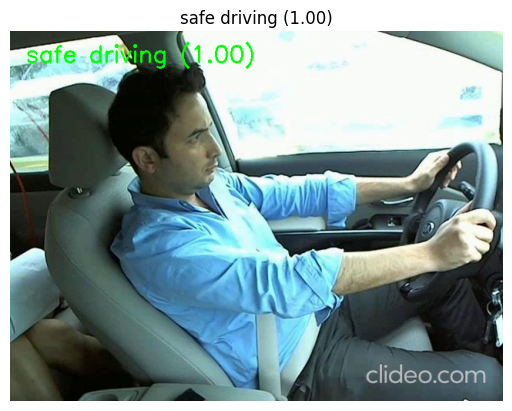


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c4 1.00, c8 0.00, c9 0.00, c2 0.00, c6 0.00, 74.3ms
Speed: 14.2ms preprocess, 74.3ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 165 → talking on the phone - left (1.00)


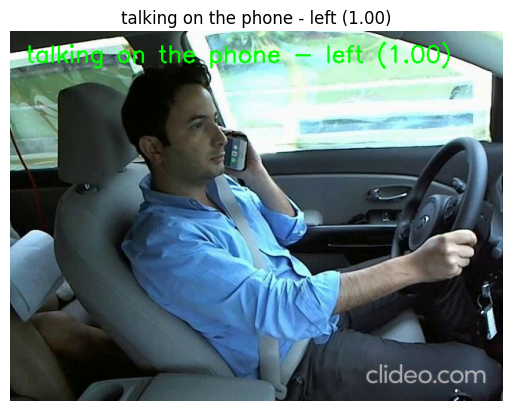


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c4 1.00, c8 0.00, c0 0.00, c9 0.00, c2 0.00, 80.9ms
Speed: 14.0ms preprocess, 80.9ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 170 → talking on the phone - left (1.00)


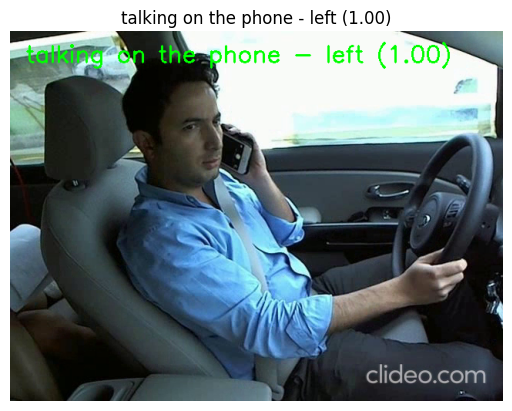


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c4 1.00, c8 0.00, c9 0.00, c2 0.00, c3 0.00, 76.2ms
Speed: 15.0ms preprocess, 76.2ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 175 → talking on the phone - left (1.00)


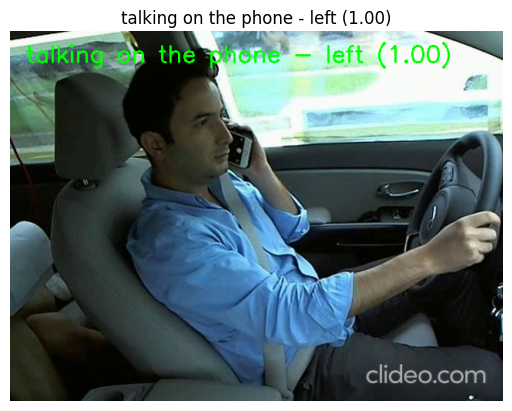


image 1/1 C:\Users\Rohit94\temp_frame.jpg: 224x224 c4 1.00, c8 0.00, c9 0.00, c6 0.00, c2 0.00, 88.6ms
Speed: 15.5ms preprocess, 88.6ms inference, 0.0ms postprocess per image at shape (1, 3, 224, 224)
Frame 180 → talking on the phone - left (1.00)


In [ ]:
import cv2
from ultralytics import YOLO
import os
import matplotlib.pyplot as plt
# Load trained YOLOv8 classification model
model = YOLO(r"C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes/best_classify.pt")

# Descriptive class names
classes = [
    'safe driving',                    # c0
    'texting - right',                 # c1
    'talking on the phone - right',    # c2
    'texting - left',                  # c3
    'talking on the phone - left',     # c4
    'operating the radio',             # c5
    'drinking',                        # c6
    'reaching behind',                 # c7
    'hair and makeup',                 # c8
    'talking to passenger'             # c9
]

# Function to predict on video
def predict_video(video_path, frame_skip=5, show=True):
    cap = cv2.VideoCapture(video_path)
    frame_id = 0

    while True:
        ret, frame = cap.read()
        if not ret:
            break

        if frame_id % frame_skip == 0:
            frame_path = "temp_frame.jpg"
            cv2.imwrite(frame_path, frame)

            result = model(frame_path)[0]
            class_index = result.probs.top1
            class_name = classes[class_index]
            confidence = result.probs.top1conf

            label = f"{class_name} ({confidence:.2f})"
            print(f"Frame {frame_id} → {label}")

            if show:
                annotated = frame.copy()
                cv2.putText(annotated, label, (20, 40), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2)
                rgb_frame = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
                plt.imshow(rgb_frame)
                plt.title(label)
                plt.axis('off')
                plt.show()

        frame_id += 1

    cap.release()


# Example usage
predict_video(r"C:\Users\Rohit94\Documents\project_2023\DriverAlertAwarenes/abcd.mp4")  # Replace with your video path